<img src="http://www.cidaen.es/assets/img/mCIDaeNnb.png" alt="Logo CiDAEN" align="right">

<h1><font size=4>Trabajo Fin de Master (TFM)</font></h1>
<br>
<h2><font size=6>WiDS Datathon 2024 - Challenge 2</font></h2>
<h3><font size=5>Modelos de regresión para estimación del periodo de diagnóstico metastático</font></h3>
<h3><font size=5>Parte 1 - Análisis Exploratorio de Datos</font></h3>
<br>
<h1><font size=4>Alumna: Luna Jiménez Fernández</font></h1>
<br>



<div align="right">
<font size=3>Máster en Ciencia de Datos e Ingeniería de Datos en la Nube</font><br>
<font size=3>Universidad de Castilla-La Mancha</font>
</div>

<br>

---

INTRO A LA LIBRETA

In [78]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:98% !important; }</style>"))

# Python and Jupyter libraries
import itertools
from IPython.display import Image
import io
import PIL
from pathlib import Path

# Array manipulation libraries
import numpy as np
import pandas as pd

# Statistical methods
from scipy.stats import kruskal, f_oneway

# Importing visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import geopandas as gpd
sns.set()

%config InlineBackend.figure_format = 'retina'
%matplotlib inline

---

# Índice

* [1. Explicación y carga del conjunto de datos](#section1)
    * [1.1. Descripción del conjunto de datos](#section1-1)
    * [1.2. Características y variable objetivo](#section1-2)
    * [1.3. Carga inicial y verificación](#section1-3)
* [2. Análisis exploratorio de datos (EDA)](#section2)
    * [2.1. Exploración inicial](#section2-1)
    * [2.2. Valores perdidos](#section2-2)
    * [2.3. Estudio de atributos categóricos](#section2-3)
    * [2.4. Estudio de atributos numéricos](#section2-4)
    * [2.5. Estudio de atributos geoeconómicos y climáticos](#section2-5)
    * [2.6. Conclusiones del análisis](#section2-6)

---

<a id="section1"></a>
# 1. Explicación y carga del conjunto de datos

En este apartado se procede a explicar tanto el **problema a resolver** como las **variables disponibles** dentro del conjunto de datos. 

Tras esto, se realiza la **carga inicial** del conjunto - comprobando que no exista ningún problema con los datos.

---

<a id="section1-1"></a>
## 1.1. Descripción del conjunto de datos
<br>

La desigualdad a la hora de acceder a los servicios médicos es uno de los principales problemas a nivel global en la actualidad. Ahora bien, pueden existir motivos adiciones que afecten a este acceso - como la **condición socioeconómica** o los **patrones climáticos**.

El **objetivo** de este conjunto de datos es **estudiar la relación** que existe entre estos factores (económicos y climáticos) y el **tiempo necesario para que los pacientes reciban un diagnóstico** - en este caso concreto, se busca crear modelos de **regresión** capaces de predecir el tiempo necesario para recibir un diagnóstico de **metástasis de cancer** en base a diversos factores médicos, demográficos y climáticos.

El problema expuesto fue el **segundo desafío** del **Women in Data Science (*WiDS*) Datathon** del año 2024, disponible en el [siguiente enlace](https://www.kaggle.com/competitions/widsdatathon2024-challenge2/overview).

---

<a id="section1-2"></a>
## 1.2. Características y variable objetivo
<br>

Como se ha comentado previamente, el conjunto de datos contiene información **médica**, **demográfica** y **climática** sobre aproximádamente **19.000 pacientes estadounidenses** con diagnóstico de metástasis - incluyendo como objetivo a predecir el **tiempo que se ha tardado en recibir un diagnóstico**.

Desglosando en más detalle las **variables** contenidas en el conjunto de datos:

### Variable objetivo

La variable que se busca predecir es **`metastatic_diagnosis_period`**.

Esta variable numérica representa el **tiempo (en días) transcurrido entre el primer diagnóstico de cancer y el diagnóstico de metástasis**.

### Variables predictoras

Las **variables predictoras** utilizadas para predecir la variable objetivo se pueden dividir en **tres grandes grupos**, dependiendo del tipo de información que aportan:

#### Variables médicas y relacionadas con el paciente

En general, estas variables se refieren a datos personales del paciente en el momento del diagnóstico - principalmente **datos identificativos y médicos**.

- `patient_id`: Identificador único del paciente.
- `patient_race`: Identificador de la raza del paciente.
- `payer_type`: Tipo de seguro médico (Medicaid, Comercial...).
- `patient_state`: Estado (Alabama, Arkansas...) en el que se encontraba el paciente.
- `patient_zip3`: Primeros tres dígitos del codigo ZIP (equivalente al código postal) del paciente.
- `patient_age`: Edad del paciente.
- `patient_gender`: Género del paciente (masculino o femenino).
- `bmi`: Índice de Masa Corporal (*IMC*) del paciente tomado **tras el diagnóstico**.
- `breast_cancer_diagnosis_code`: Código ICD (*International Classification of Diseases*) del tipo de diagnóstico. Puede ser un código **ICD09** o **ICD10**.
- `breast_cancer_diagnosis_desct`: Descripción en texto plano del código ICD.
- `metastatic_cancer_diagnosis_code`: Código ICD10 del diagnóstico.
- `metastatic_first_novel_treatment`: Nombre de la medicación utilizada en el **primer tratamiento** tras el diagnóstico.
- `metastatic_first_novel_treatment_type`: Descripción del tipo de medicación utilizado en el **primer tratamiento** tras el diagnóstico.

#### Variables socioeconómicas

Estas variables están referidas a datos **socioeconómicos** relacionados con la ubicación geográfica del paciente en el momento del diagnóstico. Por lo general, son datos estadísticos asociados al **estado** y **código zip** del paciente - y no varían entre pacientes ubicados en el mismo lugar.

Se pueden agrupar de nuevo estas variables en tres sub-conjuntos:

##### *- Variables referidas al porcentaje de la población*

Estas variables se refieren a **estadísticas socioeconómicas y demográficas** asociadas a la población del código zip. 
Concretamente, todas las variables dentro de esta sección están representadas como el **porcentaje de la población** que cumple la descripción.

- `male`: Personas identificadas como hombres.
- `female`: Personas identificadas como mujeres.
- `married`: Personas casadas.
- `divorced`: Personas divorciadas.
- `never_married`: Personas que nunca han contraido matrimonio.
- `widowed`: Personas viudas.
- `education_college_or_above`: Residentes con estudios universitarios o superiores (de, al menos, cuatro años)
- `labor_force_participation`: Residentes con trabajos (incluyendo solo a personas mayores de 16 años)
- `unemployment_rate`: Residentes en el paro.
- `disabled`: Residentes con alguna discapacidad.
- `limited_english`: Residentes que hablan inglés de forma limitada.
- `health_uninsured`: Residentes sin seguro médico.
- `veteran`: Residentes veteranos del ejercito.
- `income_household_six_figure`: Hogares con ingresos superiores a *100.000* dolares.
- `home_ownership`: Hogares con casa en propiedad.
- `poverty`: Hogares viviendo por debajo del umbral de la pobreza.
- `self_employed`: Hogares con ingresos provenientes de actividades autónomas.
- `farmer`: Hogares con ingresos provenientes de trabajos en el campo.

Además, existe varios conjuntos de variables que se refieren al **porcentaje de la población que pertenece a una categoría dentro de una variable concreta**.

Las siguientes variables hacen referencia a la **raza** de la población:
- `race_white`: Residentes de raza blanca.
- `race_black`: Residentes de raza negra o afroamericana.
- `race_asian`: Residentes de raza asiática.
- `race_native`: Residentes de raza nativa (americana, Alaska...)
- `race_pacific`: Residentes de raza del pacífico (hawaianos y otras islas del oceano Pacífico)
- `race_other`: Residentes cuya raza no está incluida en las razas anteriores.
- `race_multiple`: Residentes con dos o más razas.
- *`hispanic`*: Residentes latinos o hispánicos - entendiendo en este caso "hispano" como una **etnicidad** y no una raza.

Las siguientes variables hacen referencia a la **edad** de la población:
- `age_under_10`: Residentes entre 0 y 9 años.
- `age_10_to_19`: Residentes entre 10 y 19 años.
- `age_20s`: Residentes entre 20 y 29 años.
- `age_30s`: Residentes entre 30 y 39 años.
- `age_40s`: Residentes entre 40 y 49 años.
- `age_50s`: Residentes entre 50 y 59 años.
- `age_60s`: Residentes entre 60 y 69 años.
- `age_70s`: Residentes entre 70 y 79 años.
- `age_over_80`: Residentes de más de 80 años.

Las siguientes variables hacen referencia a los **ingresos** de los hogares:
- `income_household_under_5`: Hogares con ingresos inferiores a *5.000* dolares.
- `income_household_5_to_10`: Hogares con ingresos entre *5.000* y *10.000* dolares.
- `income_household_10_to_15`: Hogares con ingresos entre *10.000* y *15.000* dolares.
- `income_household_15_to_20`: Hogares con ingresos entre *15.000* y *20.000* dolares.
- `income_household_20_to_25`: Hogares con ingresos entre *20.000* y *25.000* dolares.
- `income_household_25_to_35`: Hogares con ingresos entre *25.000* y *35.000* dolares.
- `income_household_35_to_50`: Hogares con ingresos entre *35.000* y *50.000* dolares.
- `income_household_50_to_75`: Hogares con ingresos entre *50.000* y *75.000* dolares.
- `income_household_75_to_100`: Hogares con ingresos entre *75.000* y *100.000* dolares.
- `income_household_100_to_150`: Hogares con ingresos entre *100.000* y *150.000* dolares.
- `income_household_150_over`: Hogares con ingresos superiores a *150.000* dolares.

Las siguientes variables hacen referencia al **nivel de estudio** de la población:
- `education_less_highschool`: Residentes sin estudios de secundaria o superiores.
- `education_highschool`: Residentes con estudios de secundaria, pero no superiores.
- `education_some_college`: Residentes con algún estudio universitario, pero no superior.
- `education_bachelor`: Residentes con un grado universitario (o equivalente), pero no superior.
- `education_graduate`: Residentes con estudios post-grado o superior.
- *`education_stem_degree`*: Residentes con un grado universitario (o equivalente) o superior, en un campo **STEM** (*Science, Technology, Engineering, Mathematics*) - un subconjunto de las dos variables anteriores.

##### *- Variables referidas a la mediana del valor en la población*

Estas variables, de nuevo, se refieren a **estadísticas socioeconómicas** asociadas a la población del código zip.

En este caso, las variables representan la **mediana** del valor en la población para el atributo descrito.

- `age_median`: Edad de los residentes.
- `income_household_median`: Ingresos del hogar (en dólares)
- `income_individual_median`: Ingresos por persona (en dólares)
- `home_value`: Valor de las residencias de loshogares (teniendo en cuenta únicamente los hogares en propiedad)
- `rent_median`: Coste del alquiler.
- `rent_burden`: Coste del alquiler - representado como el **porcentaje del ingreso del hogar** dedicado a pagar el alquiler.
- `commute_time`: Tiempo que se tarda en llegar al trabajo (en minutos)
- `poverty`: Hogares viviendo por debajo del umbral de la pobreza.
- `self_employed`: Hogares con ingresos provenientes de actividades autónomas.
- `farmer`: Hogares con ingresos provenientes de trabajos en el campo.

##### *- Otras variables geo-demográficas asociadas al código Zip*

Estas variables están asociadas a la **ubicación geográfica** y los detalles estadísticos relacionados - pero no representan un porcentaje o una mediana.

- `region`: Región en la que se ubica el paciente.
- `division`: División en la que se ubica el paciente.
- `population`: Población estimada asociada al código Zip.
- `density`: Densidad de población estimada asociada al código Zip (en personas por kilómetro cuadrado)
- `family_size`: Tamaño promedio de las familias en la población asociada al código Zip.
- `housing_units`: Número de hogares en la población.

#### Variables climáticas

Además de las variables médicas y socioeconómicas descritas en los dos puntos anteriores, existe un conjunto de **72 variables** representando la **temperatura promedio (*en grados Farenheit*)** asociada a la ubicación del código zip. Todas las variables tienen el siguiente aspecto:

> `Average of <MES>-<AÑO>`

Donde:

- `MES`: El mes del año, representado en formato de mes de tres letras (*Jan, Feb, Mar...*)
- `AÑO`: El año en el que se ha realizado la medición - entre **2013** y **2018** - en formato ISO de año de dos cifras (*13, 14, 15...*)

---

<a id="section1-3"></a>
## 1.3. Carga inicial y verificación del conjunto de datos
<br>

El último paso antes de realizar un análisis exploratorio es **cargar el conjunto de datos** a un *DataFrame*.

En este caso, hay disponibles **dos** ficheros conteniendo datos estructurados de forma tabular en formato `.csv`:
- `data/train.csv`: Conjunto de **entrenamiento**.
- `data/test.csv`: Conjunto de **test**.

Para evitar posibles fugas de datos y hacer un análisis exploratorio de los datos más honesto, se cargará y trabajará durante toda la libreta con el **conjunto de entrenamiento** - de ahora en adelante llamado `df_metastasis`:

In [2]:
# Loading the full training dataset - for EDA purposes
df_metastasis = pd.read_csv(
    "data/train.csv",
    index_col="patient_id"          # Using patient_id as ID for the dataframe
)

# Display the first ten entries to ensure that nothing is missing
display(df_metastasis.head(10))

# Display the shape
print(f"Shape: {df_metastasis.shape}")

,patient_race,payer_type,patient_state,patient_zip3,Region,Division,patient_age,patient_gender,bmi,breast_cancer_diagnosis_code,...,Average of Apr-18,Average of May-18,Average of Jun-18,Average of Jul-18,Average of Aug-18,Average of Sep-18,Average of Oct-18,Average of Nov-18,Average of Dec-18,metastatic_diagnosis_period
patient_id,,,,,,,,,,,,,,,,,,,,,
268700,NaN,COMMERCIAL,AR,724,South,West South Central,39,F,NaN,C50912,...,52.55,74.77,79.96,81.69,78.30,74.56,59.98,42.98,41.18,191
484983,White,NaN,IL,629,Midwest,East North Central,55,F,35.36,C50412,...,49.30,72.87,77.40,77.43,75.83,72.64,58.36,39.68,39.71,33
277055,NaN,COMMERCIAL,CA,925,West,Pacific,59,F,NaN,1749,...,68.50,70.31,78.61,87.24,85.52,80.75,70.81,62.67,55.58,157
320055,Hispanic,MEDICAID,CA,900,West,Pacific,59,F,NaN,C50911,...,63.34,63.10,67.45,75.86,75.24,71.10,68.95,65.46,59.46,146
190386,NaN,COMMERCIAL,CA,934,West,Pacific,71,F,NaN,1748,...,59.45,60.24,64.77,69.81,70.13,68.10,65.38,60.72,54.08,286
559027,NaN,COMMERCIAL,IN,461,Midwest,East North Central,63,F,NaN,1749,...,45.86,71.10,74.27,74.89,74.57,70.70,55.43,37.13,35.43,73
293747,White,MEDICARE ADVANTAGE,OH,448,Midwest,East North Central,57,F,33.10,C50412,...,42.62,65.91,71.26,74.03,73.94,69.12,53.50,36.43,34.10,59
517596,White,COMMERCIAL,DE,198,South,South Atlantic,56,F,31.05,C50411,...,48.41,65.17,70.63,75.82,76.17,70.00,56.65,40.90,37.68,316
533188,NaN,COMMERCIAL,LA,706,South,West South Central,65,F,NaN,C50212,...,63.74,77.51,81.80,83.07,82.46,80.32,71.56,56.24,53.39,86


Shape: (13173, 151)


El conjunto de datos parece cargarse adecuadamente, y los valores de las variables son consistentes a simple vista - si bien hay algunos valores perdidos.

Ahora bien, es necesario un análisis más exhaustivo para comprender mejor los datos - y estudiar las relaciones que existen entre éstos y el tiempo de diagnóstico.

---

<a id="section2"></a>

# 2. Análisis exploratorio de datos (EDA)

Una vez se ha cargado el conjunto de datos, el primer paso en el proceso de la Ciencia de Datos consiste en realizar un **análisis exploratorio de datos (*EDA*)** - estudiar el conjunto de datos con el fin de conocerlo mejor, de cara a poder enfocar el procesamiento y la creación de modelos posterior.

Para ello, se va a realizar una exploración detallada del conjunto de datos completo - con el objetivo de **entender mejor el comportamiento de los datos**.

---

<a id="section2-1"></a>

## 2.1. Exploración inicial

El primer paso para estudiar el conjunto de datos es **comprobar su tamaño** - el número de instancias y el número de variables:

In [3]:
# Extract number of entries and number of columns
entries, columns = df_metastasis.shape
print(f"Número de instancias: {entries}")
print(f"Número de variables total: {columns}")
print(f"\tAtributos: {columns-1}")
print(f"\tVariable objetivo: 1")

Número de instancias: 13173
Número de variables total: 151
	Atributos: 150
	Variable objetivo: 1


A primera vista, el conjunto contiene **13173 instancias** - un número considerable, pero que puede resultar limitado si se quisieran usar modelos más complejos de aprendizaje profundo.

Además, cada instancia contiene valores para **151** variables - **150 atributos** y la **variable a predecir**. El número de variables es elevado, por lo que será necesario estudiar la relevancia de las variables para poder realizar una **selección de atributos**.

---

El siguiente paso sería estudiar los **tipos de las variables** - estudiar cuantas de las variables son **numéricas**, y cuantas son **categóricas**.

In [4]:
# Separate the numerical and categorical variables
df_numerical = df_metastasis.select_dtypes(include=["int64", "float64"])
df_categorical = df_metastasis.select_dtypes(include=["object"])

print(f"Variables numéricas: {len(df_numerical.columns)} (incluyendo la variable objetivo)")
print(f"Variables categóricas: {len(df_categorical.columns)}")

Variables numéricas: 140 (incluyendo la variable objetivo)
Variables categóricas: 11


De los **150 atributos** que se tienen:
- La amplia mayoría (**139**) y la **variable objetivo** son variables numéricas.
- Los atributos restantes (**11**) son **categóricos**.

Los atributos categóricos y algunos de sus valores estadísticos son los siguientes:

In [5]:
print("Atributos categóricos:")
display(
    df_categorical.describe().transpose()
)

Atributos categóricos:


,count,unique,top,freq
patient_race,6516,5,White,3565
payer_type,11408,3,COMMERCIAL,6297
patient_state,13173,44,CA,2377
Region,13173,4,South,3960
Division,13173,8,East North Central,3010
patient_gender,13173,1,F,13173
breast_cancer_diagnosis_code,13173,47,1749,1947
breast_cancer_diagnosis_desc,13173,47,"Malignant neoplasm of breast (female), unspeci...",1947
metastatic_cancer_diagnosis_code,13173,43,C773,7308
metastatic_first_novel_treatment,11,2,OLAPARIB,6


Como se puede observar, **algunos atributos tienen valores inesperados** - ya sean **una elevada cantidad de valores perdidos** o **tener un único valor en todos los atributos**. Esto se estudiará en más detalle en las secciones posteriores.

Debido al gran número de valores numéricos, no se pueden mostrar todas las variables a la vez. Aun así, se puede observar una muestra de los atributos numéricos y sus valores estadísticos:

In [6]:
print("Atributos numéricos:")
display(
    df_numerical.describe().transpose()
)

Atributos numéricos:


,count,mean,std,min,25%,50%,75%,max
patient_zip3,13173.0,568.530859,275.758485,100.00,330.000,557.00,832.00,995.00
patient_age,13173.0,59.271313,13.218883,18.00,50.000,59.00,67.00,91.00
bmi,4102.0,29.168808,5.752820,15.00,24.825,28.58,33.00,97.00
population,13173.0,20651.373928,13840.379638,635.55,9160.340,18952.78,30021.28,71374.13
density,13173.0,1776.872376,3876.061897,0.92,163.150,700.34,1666.52,29851.69
...,...,...,...,...,...,...,...,...
Average of Sep-18,13166.0,71.417027,6.502875,51.83,67.020,70.88,75.64,89.19
Average of Oct-18,13166.0,59.323286,9.261934,37.54,51.970,57.45,67.36,81.46
Average of Nov-18,13161.0,46.100150,12.245594,19.15,35.560,42.43,55.73,76.30
Average of Dec-18,13140.0,42.096213,11.209011,15.38,33.370,38.50,50.50,73.54


Todos los atributos numéricos parecen tener comportamientos esperables - aunque sus distribuciones se observarán en más detalle en secciones posteriores.

Ahora bien, la variable `patient_zip3` está clasificada como una **variable numérica**. Si se estudia su comportamiento:

In [7]:
display(
    df_metastasis.head(10)
    .sort_values(by="patient_zip3")
)

,patient_race,payer_type,patient_state,patient_zip3,Region,Division,patient_age,patient_gender,bmi,breast_cancer_diagnosis_code,...,Average of Apr-18,Average of May-18,Average of Jun-18,Average of Jul-18,Average of Aug-18,Average of Sep-18,Average of Oct-18,Average of Nov-18,Average of Dec-18,metastatic_diagnosis_period
patient_id,,,,,,,,,,,,,,,,,,,,,
517596,White,COMMERCIAL,DE,198,South,South Atlantic,56,F,31.05,C50411,...,48.41,65.17,70.63,75.82,76.17,70.00,56.65,40.90,37.68,316
293747,White,MEDICARE ADVANTAGE,OH,448,Midwest,East North Central,57,F,33.10,C50412,...,42.62,65.91,71.26,74.03,73.94,69.12,53.50,36.43,34.10,59
559027,NaN,COMMERCIAL,IN,461,Midwest,East North Central,63,F,NaN,1749,...,45.86,71.10,74.27,74.89,74.57,70.70,55.43,37.13,35.43,73
484983,White,NaN,IL,629,Midwest,East North Central,55,F,35.36,C50412,...,49.30,72.87,77.40,77.43,75.83,72.64,58.36,39.68,39.71,33
533188,NaN,COMMERCIAL,LA,706,South,West South Central,65,F,NaN,C50212,...,63.74,77.51,81.80,83.07,82.46,80.32,71.56,56.24,53.39,86
268700,NaN,COMMERCIAL,AR,724,South,West South Central,39,F,NaN,C50912,...,52.55,74.77,79.96,81.69,78.30,74.56,59.98,42.98,41.18,191
320055,Hispanic,MEDICAID,CA,900,West,Pacific,59,F,NaN,C50911,...,63.34,63.10,67.45,75.86,75.24,71.10,68.95,65.46,59.46,146
639484,White,COMMERCIAL,CA,922,West,Pacific,60,F,NaN,C50912,...,70.91,74.48,83.59,91.04,89.79,85.10,70.73,60.59,53.04,184
277055,NaN,COMMERCIAL,CA,925,West,Pacific,59,F,NaN,1749,...,68.50,70.31,78.61,87.24,85.52,80.75,70.81,62.67,55.58,157


El valor de `patient_zip3` no parece comportarse tanto como una variable numérica como una **variable categórica** - donde cada valor discreto representa una región del país. Esto se corresponde con su comportamiento descrito, y con **como será estudiada a continuación**.

In [8]:
# Move zip3 from numerical variables to categorical variables
if "patient_zip3" in df_numerical:
    df_categorical["patient_zip3"] = df_numerical["patient_zip3"].astype("str")
    df_numerical = df_numerical.drop(columns="patient_zip3")

Los dos tipos de atributos deben ser tratados de forma distinta durante el estudio y el pre-procesamiento de los datos; por lo que se estudiarán las dos categorías de forma separada.

---

Finalmente, se estudia la **distribución de la variable objetivo** - `metastatic_diagnosis_period`:

In [75]:
df_metastasis["metastatic_diagnosis_period"].describe()

count    13173.000000
mean        96.515221
std        108.969873
min          0.000000
25%          3.000000
50%         44.000000
75%        181.000000
max        365.000000
Name: metastatic_diagnosis_period, dtype: float64

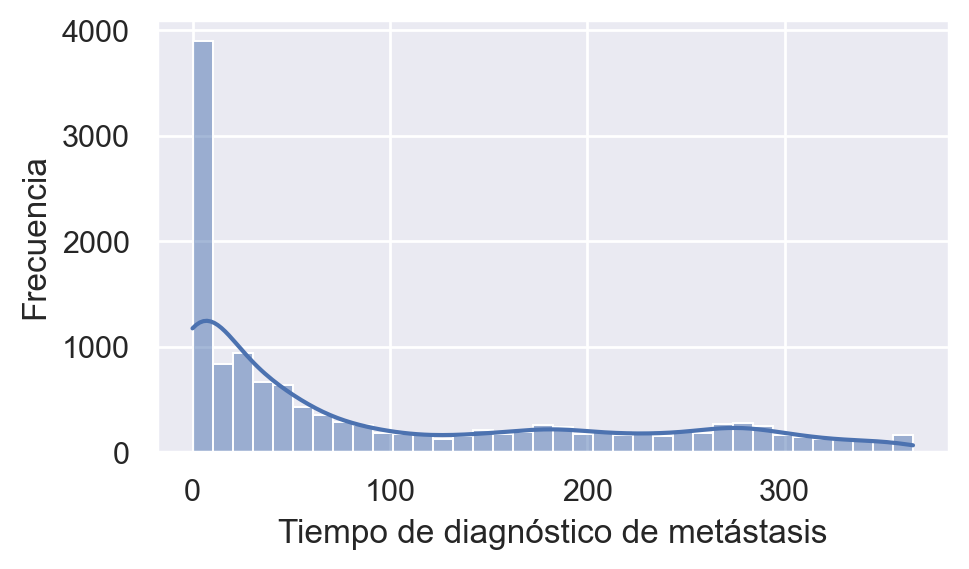

In [9]:
# Create the figure
plt.figure(figsize=(5, 3));

# Create a Histogram to display the distribution of the class variable
ax = sns.histplot(
    data=df_metastasis,
    x="metastatic_diagnosis_period",
    binwidth=10,
    kde=True
);

# Set a title and X/Y labels
ax.set(
    xlabel="Tiempo de diagnóstico de metástasis",
    ylabel="Frecuencia"
);

# Show the figure
plt.tight_layout();
plt.savefig("thesis/figs/chapter3/objectivevariable/diagnosisperioddistribution.pdf", format="pdf", bbox_inches="tight")
plt.show();

A simple vista, se observa que **la mayoría de casos** (aproximadamente *4000*) han recibido un diagnóstico de metástasis en un plazo menor a **10 días**. Ahora bien hay una cola significativa en la distribución - hay una cantidad de casos considerables que tardan un tiempo mayor, habiendo algunos *outliers* que pueden llegar a tardar **más de 350 días**.

De esta forma, parece que salvo casos aislados, la gran mayoría de casos tienen un diagnóstico muy rápido. Ahora bien, si se discretiza la variable en varios conjuntos:

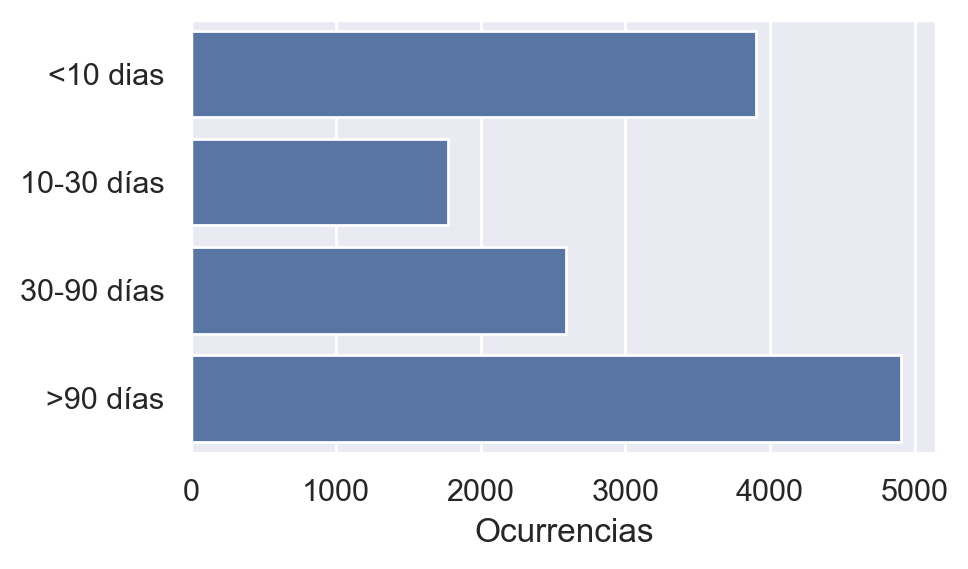

In [10]:
# Create the figure
plt.figure(figsize=(5, 3));

# Create a bar plot
ax = sns.countplot(
    # Data is divided into discrete ranges
    data = (pd.cut(df_metastasis["metastatic_diagnosis_period"],
           [-np.inf, 10, 30, 90, np.inf],
           labels=["<10 dias", "10-30 días", "30-90 días", ">90 días"]))
)

# Set a title and X/Y labels
ax.set(
    xlabel="Ocurrencias",
    ylabel="",
);

# Show the figure
plt.tight_layout();
plt.savefig("thesis/figs/chapter3/objectivevariable/diagnosisperiodgrouped.pdf", format="pdf", bbox_inches="tight")
plt.show();

Si se observa la distribución de esta forma, se evidencia que aunque una cantidad considerable de los casos reciben un diagnóstico breve, **la mayoría de los casos tarda más de 90 días en ser diagnosticado**.

En las siguientes secciones se estudiarán los atributos del conjunto de datos de forma más pormenorizada.

---

<a id="section2-2"></a>

## 2.2. Valores perdidos

Antes de estudiar las distribuciones de los atributos y su relación con la variable objetivo, es interesante estudiar los **valores perdidos** en el conjunto de datos.

Al haber un número de variables muy elevado, se realizará un **estudio estadístico**:

In [11]:
# Missing values per column
missing_values = (
    # Obtain the number of missing values per column
    df_metastasis.isna()
    .sum()
)
# Columns with missing values
missing_values_cols = missing_values.apply(lambda e: e != 0)
# Total number of missing values
missing_values_total = missing_values_cols.sum()

print(f"Número de atributos con valores perdidos: {missing_values_total}")
print("Estadísticas de los valores perdidos:")
display(missing_values.loc[missing_values_cols].describe())


Número de atributos con valores perdidos: 72
Estadísticas de los valores perdidos:


count       72.000000
mean       624.013889
std       2512.579307
min          1.000000
25%          5.000000
50%          8.000000
75%         20.250000
max      13162.000000
dtype: float64

De los 150 atributos, **72** de ellos contienen valores perdidos. En promedio, cada atributo tiene **624 valores perdidos**.

Ahora bien, la distribución de estos valores perdidos está **sesgada** - la amplia mayoría de atributos tiene muy pocos valores perdidos, habiendo un número reducido de variables que contiene la amplia mayoria de los valores perdidos.

Si se estudian los valores perdidos de los **10 atributos con mayor número de valores perdidos**:

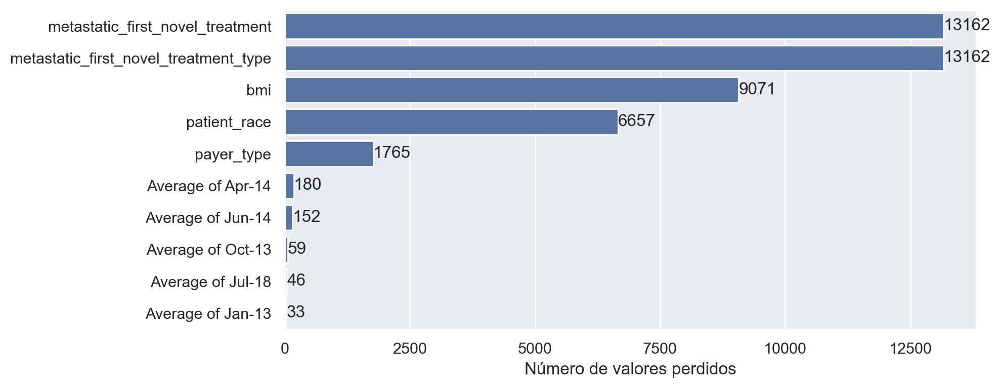

In [12]:
# Create the figure
plt.figure(figsize=(10, 4));

# Create a bar plot
ax = sns.barplot(
    # Data is ordered, and only the first 20 variables are kept
    data = (
        missing_values.loc[missing_values_cols]
        .sort_values(ascending=False)
        .nlargest(10)
    ),
    orient="h"
)

# Add numbers to each bar
ax.bar_label(ax.containers[0])

# Set a title and X/Y labels
ax.set(
    xlabel="Número de valores perdidos",
    ylabel="",
);

# Add more ticks to the X label
ax.set_xticks(range(0, 15000, 2500));

# Show the figure
plt.tight_layout();
plt.savefig("thesis/figs/chapter3/missingvalues.pdf", format="pdf", bbox_inches="tight")
plt.show();

Como se había comentado previamente, la gran mayoría de valores perdidos están concentrados en **cinco variables**:

- **`metastatic_first_novel_treatment` y `metastatic_first_novel_treatment_type`**: La medicina y el tipo de tratamiento aplicado tras el diagnóstico de metástasis. En este caso, **la práctica totalidad de las instancias no contiene valor para estas variables**.
    - Al tener únicamente **11 valores**, el atributo no resulta de interés para el estudio - y por tanto, lo más razonable sería **eliminarlo**.
- **`bmi`**: El índice de masa corporal. En este caso, **la mayoría de las instancias tienen un valor perdido** para este atributo.
    - A diferencia del caso anterior, hay un mayor número de valores. Ahora bien, al ser una variable numérica, **no hay un valor por defecto por el que se puedan reemplazar los valores perdidos** - por lo que sería también razonable **eliminar el atributo**.
- **`patient_race`**: La raza del paciente. Aproximadamente **la mitad de las instancias** tienen un valor perdido.
    - En este caso, puede resultar de interés **considerar los valores perdidos como un valor separado del atributo (*"Desconocido"*)**.
- **`payer_type`**: El tipo de seguro médico del paciente. Si bien es un número mucho más reducido, **aproximadamente una de cada diez instancias no tiene un valor para este atributo**.
    - Igual que en el caso anterior, puede ser de interés **considerar los valores perdidos como un valor separado del atributo (*Desconocido*)**

Para el resto de atributos, **el número de valores perdidos es mucho más reducido**, lo que permite que sean procesados de forma distinta - **eliminando las instancias con atributos perdidos**, por ejemplo.

---

<a id="section2-3"></a>

## 2.3. Estudio de atributos categóricos

Antes de empezar el estudio, se comprueban de nuevo las variables categóricas contenidas:

In [13]:
print("Atributos categóricos:")
display(
    df_categorical.describe().transpose()
)

Atributos categóricos:


,count,unique,top,freq
patient_race,6516,5,White,3565
payer_type,11408,3,COMMERCIAL,6297
patient_state,13173,44,CA,2377
Region,13173,4,South,3960
Division,13173,8,East North Central,3010
patient_gender,13173,1,F,13173
breast_cancer_diagnosis_code,13173,47,1749,1947
breast_cancer_diagnosis_desc,13173,47,"Malignant neoplasm of breast (female), unspeci...",1947
metastatic_cancer_diagnosis_code,13173,43,C773,7308
metastatic_first_novel_treatment,11,2,OLAPARIB,6


Ahora bien, hay **cuatro atributos** de esta lista que se estudiarán en una sección posterior (**Estudio de atributos geoeconómicos**):
- `Region`
- `Division`
- `patient_state`
- `patient_zip3`

Esto se debe a que **los cuatro atributos representan la misma información** con distintos grados de granularidad - y un gran subconjunto de las variables numéricas **tienen una relación directa con esta variable**, al referirse a atributos geoeconómicos del código zip, y no del propio paciente.

---

A la hora de estudiar atributos categóricos, no es posible realizar un estudio inicial de las **correlaciones** entre atributos. Por tanto, se optará por estudiar individualmente cada atributo, observando para cada uno de ellos:
- Su **distribución** de forma individual (en valores **totales** y de **porcentajes**)
- Su **distribución** en comparación con la variable objetivo.
- En caso de ser relevante, **tests estadísticos** con un **nivel de significación del 95% ($\alpha=0.05$)**:
    - **ANOVA** (test paramétrico que estudia si dos o más grupos **tienen medias iguales**).
    - **Kruskal-Wallis** (test no-paramétrico que estudia si dos o más grupos **tienen medianas iguales**).

Se incluye, además, un diccionario donde se almacenan los **p-valores** de los tests estadísticos, `categorical_p_values`:

In [14]:
categorical_p_values = {}

### **- Raza (`patient_race`**)

Como se comentó en el apartado previo, esta variable tiene un **número elevado de valores perdidos** - pero puede ser interesante estudiar estos valores perdidos como un grupo separado (*"Raza desconocida"*).

Por eso, el primer paso es el reemplazo de valores perdidos:

In [15]:
# Obtain the variable and the class
# Missing values are replaced with the "Unknown" tag
df_patient_race = (
    df_metastasis[["patient_race", "metastatic_diagnosis_period"]]
    .fillna("Unknown")
)

Tras esto, se observa la distribución de los valores de la clase:

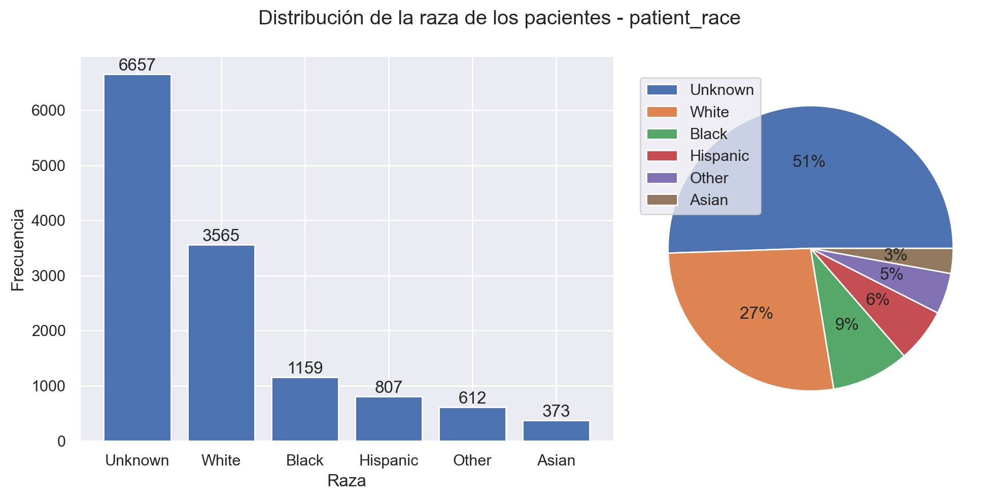

In [16]:
# Create the figure
fig, axs = plt.subplots(1, 2, 
                        figsize=(10, 5),
                        width_ratios=[1.5, 1]);

# FIGURE 1: Bar chart
axs[0].bar(x=df_patient_race["patient_race"].value_counts().index,
           height=df_patient_race["patient_race"].value_counts());
axs[0].bar_label(axs[0].containers[0]);
axs[0].set(xlabel="Raza",
           ylabel="Frecuencia")

# FIGURE 2: Pie plot
axs[1].pie(x=df_patient_race["patient_race"].value_counts(),
           autopct="%1.f%%");
axs[1].legend(df_patient_race["patient_race"].value_counts().index);

# Add a title to the figure
fig.suptitle("Distribución de la raza de los pacientes - patient_race")

# Show the figure
plt.tight_layout();
plt.show();

- Como era de esperar, **la mayor proporción de pacientes tienen una raza desconocida**. Esto podría ser relevante en el sentido de que podrían describir a pacientes que no se sienten cómodos especificando su raza.
- De las razas "conocidas", **la mayoría de pacientes son blancos** - tres veces más que la siguiente raza.
- Si bien parece que el resto de razas tienen pocos valores, hay **más pacientes de raza negra** - y los **pacientes de raza asiática** son la menor proporción.

Estudiando como se relaciona esta distribución con la variable objetivo:

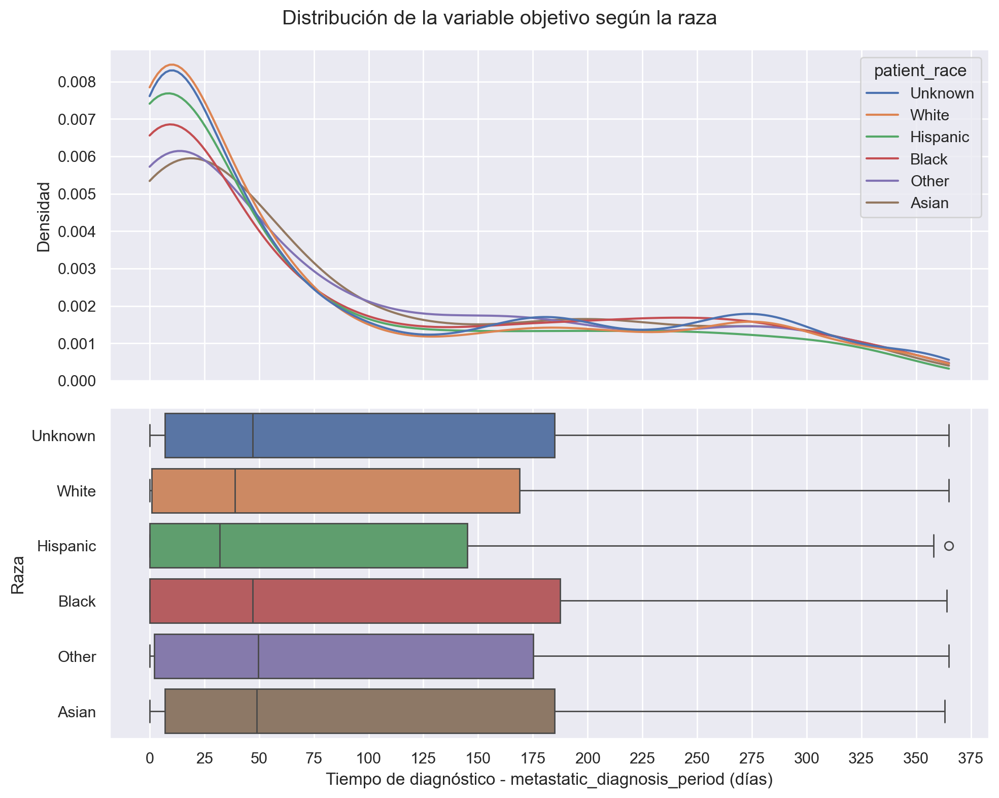

In [17]:
# Create the figures - sharing an X axis
fig, axs = plt.subplots(2, 1, 
                        figsize=(10, 8),
                        sharex=True);


# FIGURE 1 - KDE plot (density distribution)
sns.kdeplot(
    data=df_patient_race,
    x="metastatic_diagnosis_period",
    hue="patient_race",
    common_norm=False,
    clip=(0, df_patient_race["metastatic_diagnosis_period"].max()),
    ax=axs[0]
);
axs[0].set(ylabel="Densidad")

# FIGURE 2 - Box plot (distribution of values)
sns.boxplot(
    data=df_patient_race,
    y="patient_race",
    hue="patient_race",
    x="metastatic_diagnosis_period",
    ax=axs[1]
);
axs[1].set(ylabel="Raza",
           xlabel="Tiempo de diagnóstico - metastatic_diagnosis_period (días)")
axs[1].set_xticks(range(0, 400, 25));

# Add a title to the figure
plt.suptitle("Distribución de la variable objetivo según la raza")

# Show the figure
plt.tight_layout();
plt.show();

Todas las razas tienen una **distribución amplia** de valores - estando la mayoría de casos, en general, en un tiempo de diagnóstico entre **0 y 200 días**. Ahora bien:
- Las razas **blancas e hispánicas** parecen tener, en promedio, **un tiempo de diagnóstico más corto** - y, en el caso de la raza hispánica, una **distribución con un tiempo promedio más corto**.
- El resto de razas parecen tener un **tiempo de diagnóstico promedio más largo** - alrededor de los 50 días, si bien las personas cuya raza está indicada como *"Otra"* parecen tener ligeramente menos variación.

Se puede comprobar también mediante tests si **existe una diferencia estadísticamente significativa** en el tiempo de diagnóstico dependiendo de la raza. Para esto, se plantea un **test de hipótesis** con un **nivel de significación del 95%** ($\alpha=0.05$):

- $H_0$: La media del tiempo de diagnóstico es igual para todas las razas.
- $H_1$: La media del tiempo de diagnóstico es **distinta** en alguna de las razas.

In [18]:
# ANOVA (parametric test)
patient_race_anova = f_oneway(*[df_patient_race[df_patient_race["patient_race"]==race]["metastatic_diagnosis_period"].to_list() for race in df_patient_race["patient_race"].unique()])

# Kruskal-Wallis (non-parametric)
patient_race_kruskal = kruskal(*[df_patient_race[df_patient_race["patient_race"]==race]["metastatic_diagnosis_period"].to_list() for race in df_patient_race["patient_race"].unique()])

categorical_p_values["patient_race"] = {
    "anova": patient_race_anova[1],
    "kruskal": patient_race_kruskal[1]
}

print("P-Valores:")
print(f"\t- ANOVA: {categorical_p_values['patient_race']['anova']}")
print(f"\t- Kruskal-Wallis: {categorical_p_values['patient_race']['kruskal']}")

P-Valores:
	- ANOVA: 2.3634343250487747e-05
	- Kruskal-Wallis: 2.657202968637205e-09


Vistos los valores de $p$, se puede **rechazar la hipótesis nula** y afirmar que **existen diferencias en el valor promedio dependiendo de la raza** - lo que puede significar que la raza del paciente es una variable de interés.

### - Tipo de seguro médico (**`payer_type`**)

En este caso, también existe un **número elevado de valores perdidos** - aunque significativamente menor que en la raza del paciente. Por tanto, se han reemplazado estos valores perdidos por un **valor representando que no se conoce el tipo de seguro médico (*"UNKNOWN"*)**:

In [19]:
# Obtain the variable and the class
# Missing values are replaced with the "Unknown" tag
df_payer_type = (
    df_metastasis[["payer_type", "metastatic_diagnosis_period"]]
    .fillna("UNKNOWN")
)

Tras esto, se observa la distribución de los valores de la clase:

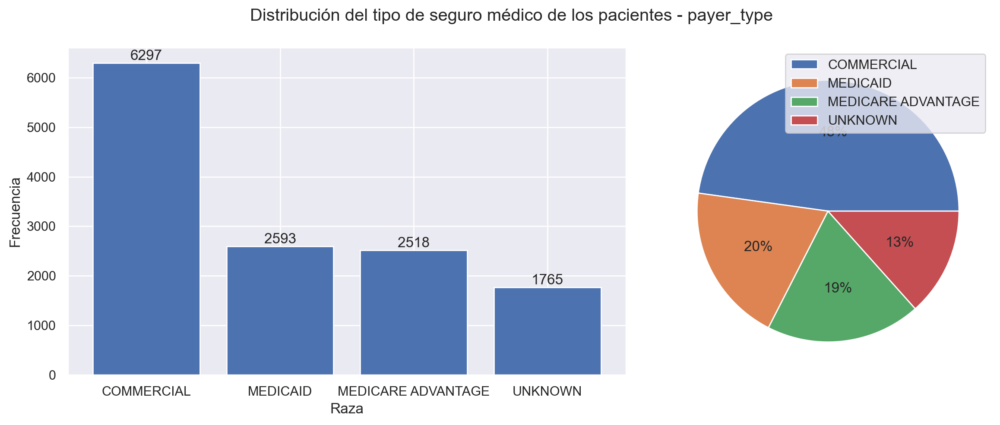

In [20]:
# Create the figure
fig, axs = plt.subplots(1, 2, 
                        figsize=(12, 5),
                        width_ratios=[1.5, 1]);

# FIGURE 1: Bar chart
axs[0].bar(x=df_payer_type["payer_type"].value_counts().index,
           height=df_payer_type["payer_type"].value_counts());
axs[0].bar_label(axs[0].containers[0]);
axs[0].set(xlabel="Raza",
           ylabel="Frecuencia")

# FIGURE 2: Pie plot
axs[1].pie(x=df_payer_type["payer_type"].value_counts(),
           autopct="%1.f%%");
axs[1].legend(df_payer_type["payer_type"].value_counts().index);

# Add a title to the figure
fig.suptitle("Distribución del tipo de seguro médico de los pacientes - payer_type")

# Show the figure
plt.tight_layout();
plt.show();

- Los seguros comerciales (**privados**) preponderan, siendo un número **mayor que si se suman el resto de tipos de seguros conocidos**.
- Los seguros **publicos** (*Medicaid* y *Medicare Advantage*) tienen aproximadamente la misma cantidad de pacientes entre sí.
- El número de personas con seguros desconocidos es más reducido al resto de valores. Esto puede referirse a personas **sin seguro** o cuyo seguro no está registrado.

Estudiando como se relaciona esta distribución con la variable objetivo:

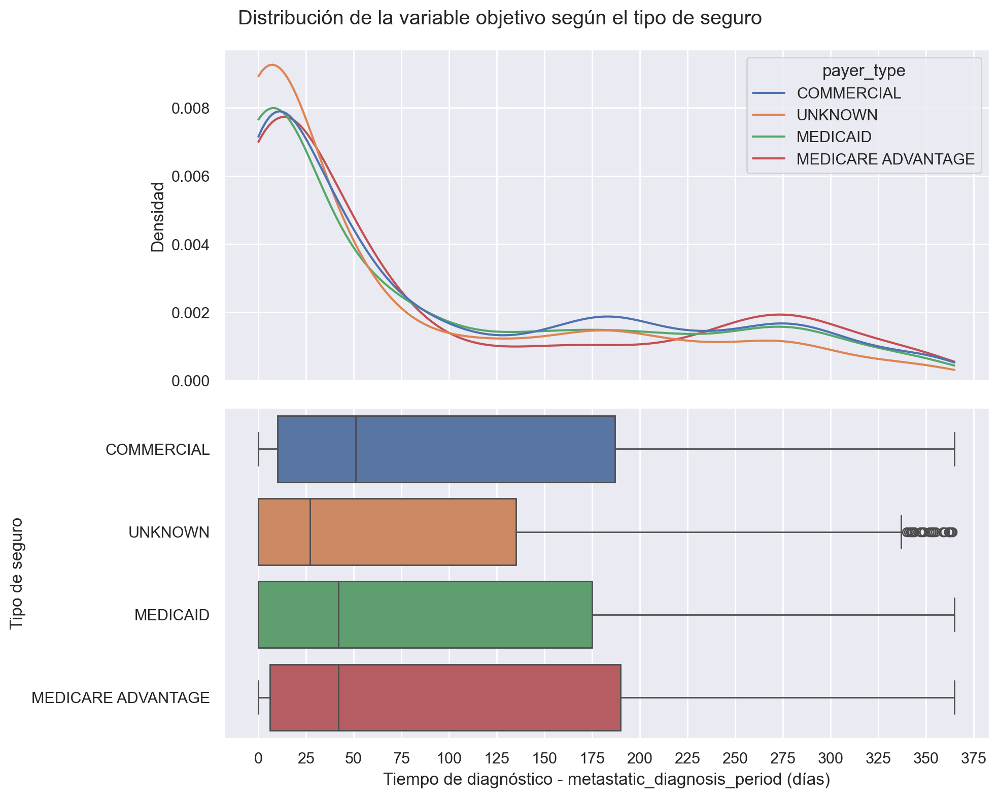

In [21]:
# Create the figures - sharing an X axis
fig, axs = plt.subplots(2, 1, 
                        figsize=(10, 8),
                        sharex=True);


# FIGURE 1 - KDE plot (density distribution)
sns.kdeplot(
    data=df_payer_type,
    x="metastatic_diagnosis_period",
    hue="payer_type",
    common_norm=False,
    clip=(0, df_payer_type["metastatic_diagnosis_period"].max()),
    ax=axs[0]
);
axs[0].set(ylabel="Densidad")

# FIGURE 2 - Box plot (distribution of values)
sns.boxplot(
    data=df_payer_type,
    y="payer_type",
    hue="payer_type",
    x="metastatic_diagnosis_period",
    ax=axs[1]
);
axs[1].set(ylabel="Tipo de seguro",
           xlabel="Tiempo de diagnóstico - metastatic_diagnosis_period (días)")
axs[1].set_xticks(range(0, 400, 25));

# Add a title to the figure
plt.suptitle("Distribución de la variable objetivo según el tipo de seguro")

# Show the figure
plt.tight_layout();
plt.show();

- En contra de lo que se podría esperar, **los seguros privados (*COMMERCIAL*) tienen el mayor tiempo de diagnóstico en promedio** - alrededor de los 50 días.
- Los dos seguros públicos (*MEDICAID* y *MEDICARE ADVANTAGE*) tienen **tiempos promedios inferiores y muy similares entre sí** - si bien parece que **el rango de tiempos de *MEDICAID* es inferior**.
- Sorprendentemente, **los casos de seguro desconocido tienen, con diferencia, el menor tiempo promedio de diagnóstico** - muy cercano a los 25 días.

Se puede comprobar también mediante tests si **existe una diferencia estadísticamente significativa** en el tiempo de diagnóstico dependiendo del tipo de seguro. Para esto, se plantea un **test de hipótesis** con un **nivel de significación del 95%** ($\alpha=0.05$):

- $H_0$: La media del tiempo de diagnóstico es igual para todas los tipos de seguro.
- $H_1$: La media del tiempo de diagnóstico es **distinta** en algun tipo de seguro.

In [22]:
# ANOVA (parametric test)
payer_type_anova = f_oneway(*[df_payer_type[df_payer_type["payer_type"]==payer_type]["metastatic_diagnosis_period"].to_list() for payer_type in df_payer_type["payer_type"].unique()])

# Kruskal-Wallis (non-parametric)
payer_type_kruskal = kruskal(*[df_payer_type[df_payer_type["payer_type"]==payer_type]["metastatic_diagnosis_period"].to_list() for payer_type in df_payer_type["payer_type"].unique()])

categorical_p_values["payer_type"] = {
    "anova": payer_type_anova[1],
    "kruskal": payer_type_kruskal[1]
}

print("P-Valores:")
print(f"\t- ANOVA: {categorical_p_values['payer_type']['anova']}")
print(f"\t- Kruskal-Wallis: {categorical_p_values['payer_type']['kruskal']}")

P-Valores:
	- ANOVA: 6.4816983897144135e-18
	- Kruskal-Wallis: 2.300180608400759e-32


Vistos los valores de $p$, se puede **rechazar la hipótesis nula** y afirmar que **existen diferencias en el valor promedio dependiendo del tipo de seguro**.

Ahora bien, es posible que este test esté sesgado por la presencia de los valores desconocidos, con un valor promedio notablemente más bajo. Si se repite el test ignorando dichos valores:

In [23]:
# ANOVA (parametric test)
payer_type_anova_no_unknown = f_oneway(*[df_payer_type[df_payer_type["payer_type"]==payer_type]["metastatic_diagnosis_period"].to_list() 
                              for payer_type in df_payer_type["payer_type"].unique() if payer_type != "UNKNOWN"])

# Kruskal-Wallis (non-parametric)
payer_type_kruskal_no_unknown = kruskal(*[df_payer_type[df_payer_type["payer_type"]==payer_type]["metastatic_diagnosis_period"].to_list() 
                               for payer_type in df_payer_type["payer_type"].unique() if payer_type != "UNKNOWN"])

categorical_p_values["payer_type_no_unknown"] = {
    "anova": payer_type_anova_no_unknown[1],
    "kruskal": payer_type_kruskal_no_unknown[1]
}

print("P-Valores (sin valores desconocidos):")
print(f"\t- ANOVA: {categorical_p_values['payer_type_no_unknown']['anova']}")
print(f"\t- Kruskal-Wallis: {categorical_p_values['payer_type_no_unknown']['kruskal']}")

P-Valores (sin valores desconocidos):
	- ANOVA: 0.0021062491032527927
	- Kruskal-Wallis: 1.2024967359448112e-08


De nuevo, observando los valores de $p$ se puede **rechazar la hipótesis nula** y afirmar que **existen diferencias en el valor promedio dependiendo del tipo de seguro**. Ahora bien, se puede ver también en este caso que **la diferencia es sustancialmente menos significativa** por varios ordenes de magnitud.

Por tanto, el tipo de seguro médico **también parece un atributo relevante** a la hora de estimar el valor de la variable objetivo.

### - **Códigos de diagnóstico del cancer original (`breast_cancer_diagnosis_code`, `breast_cancer_diagnosis_desc`)**

En el caso de estos dos atributos, por su definición **sus valores deberían estar asociados** - un **código** debería tener siempre la misma **descripción** del tipo de cancer original. 

El primer paso es confirmar esta restricción, y observar el **número de valores únicos**:

In [24]:
df_breast_cancer_diagnosis = df_metastasis[["breast_cancer_diagnosis_code", "breast_cancer_diagnosis_desc", "metastatic_diagnosis_period"]]

# Check if any code has extra descriptions, or viceversa
print("Códigos con más de una descripción:")
print((df_breast_cancer_diagnosis.groupby("breast_cancer_diagnosis_code")["breast_cancer_diagnosis_desc"].nunique() > 2).sum())

print("Descripciones con más de un código:")
print((df_breast_cancer_diagnosis.groupby("breast_cancer_diagnosis_desc")["breast_cancer_diagnosis_code"].nunique() > 2).sum())

# Check the number of pairs
print(f"\nNúmero de valores únicos: {df_breast_cancer_diagnosis['breast_cancer_diagnosis_code'].nunique()}")

Códigos con más de una descripción:
0
Descripciones con más de un código:
0

Número de valores únicos: 47


**47 códigos** es un número de valores únicos muy elevados. Además, existe la posibilidad de que **los 47 códigos no sean exhaustivos** - puede que se utilicen más codigos que no estén presentes en el conjunto de entrenamiento, lo que puede causar problemas durante el resto del proceso.

Si bien se puede ver representado en un gráfico de barras para comprobar como se distribuye la propia variable, resulta más interesante observar los **códigos y sus descripciones** en forma de lista:

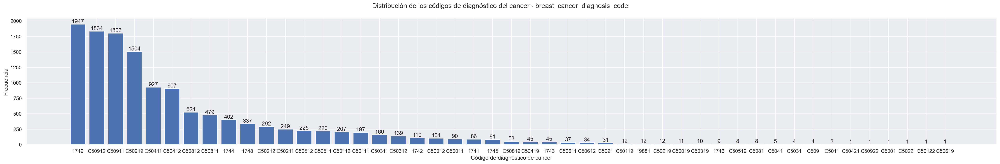

In [25]:
# Create the figure
fig = plt.figure(figsize=(30, 5));

# Create the barchart
plt.bar(x=df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"].value_counts().index,
        height=df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"].value_counts());
plt.bar_label(fig.gca().containers[0]);
plt.xlabel("Código de diagnóstico de cancer");
plt.ylabel("Frecuencia");
plt.suptitle("Distribución de los códigos de diagnóstico del cancer - breast_cancer_diagnosis_code");

# Show the figure
plt.tight_layout();
plt.show();

In [26]:
# Display the list of cancers
display(df_breast_cancer_diagnosis[["breast_cancer_diagnosis_code", "breast_cancer_diagnosis_desc"]].value_counts())

breast_cancer_diagnosis_code  breast_cancer_diagnosis_desc                                
1749                          Malignant neoplasm of breast (female), unspecified              1947
C50912                        Malignant neoplasm of unspecified site of left female breast    1834
C50911                        Malignant neoplasm of unsp site of right female breast          1803
C50919                        Malignant neoplasm of unsp site of unspecified female breast    1504
C50411                        Malig neoplm of upper-outer quadrant of right female breast      927
C50412                        Malig neoplasm of upper-outer quadrant of left female breast     907
C50812                        Malignant neoplasm of ovrlp sites of left female breast          524
C50811                        Malignant neoplasm of ovrlp sites of right female breast         479
1744                          Malignant neoplasm of upper-outer quadrant of female breast      402
1748              

Se observa que todos los códigos hacen referencias a **cánceres de mama**. Más concretamente:
- Los cuatro grupos más diagnosticados, con una diferencia sustancial, están relacionados con **cánceres en sitios sin especificar** - ya sea sin especificar la región o el pecho. Es coherente que estos sean los más frecuentes, al ser una categoría "genérica".
- Dentro de los cánceres "específicos", los más frecuentes se encuentran en **las regiones superiores** (`C50411` y `C50412`)
- Existen códigos más antiguos (empezando sin **C**) que representan otras categorías ya existentes - estos códigos se corresponden a **versiones más antiguas del estandar**.


Curiosamente, se observa que existen **cuatro instancias asociadas a hombres**. Si bien esto es una posibilidad, si se comprueban todos los atributos para dichas instancias:

In [27]:
df_metastasis[df_metastasis["breast_cancer_diagnosis_desc"].str.contains(r" male")]

,patient_race,payer_type,patient_state,patient_zip3,Region,Division,patient_age,patient_gender,bmi,breast_cancer_diagnosis_code,...,Average of Apr-18,Average of May-18,Average of Jun-18,Average of Jul-18,Average of Aug-18,Average of Sep-18,Average of Oct-18,Average of Nov-18,Average of Dec-18,metastatic_diagnosis_period
patient_id,,,,,,,,,,,,,,,,,,,,,
133511,NaN,COMMERCIAL,PA,173,Northeast,Middle Atlantic,45,F,NaN,C50421,...,47.55,66.70,70.40,75.45,75.67,69.69,56.51,40.45,36.92,7
141903,Other,MEDICAID,FL,330,South,South Atlantic,66,F,24.0,C50922,...,76.01,78.16,82.28,83.48,83.44,82.73,80.93,75.81,70.69,58
119773,NaN,NaN,CA,900,West,Pacific,53,F,NaN,C50221,...,63.34,63.10,67.45,75.86,75.24,71.10,68.95,65.46,59.46,93
222796,White,MEDICAID,CA,913,West,Pacific,49,F,NaN,C50122,...,63.25,64.01,69.54,78.40,76.72,72.64,68.64,64.03,57.70,256


Pese al código de diagnóstico indicando que los pacientes son hombres, los datos indican que los pacientes **son mujeres**. Si bien sería posible reemplazar el género de estas cuatro instancias, como se verá después, **todas las instancias tienen género femenino** - por lo que añadir estas cuatro instancias no sería util. Por tanto, se **reemplazarán los códigos de paciente a su equivalente femenino**.

Al haber gran cantidad de posibles valores de los atributos, se considerarán solo los **diez códigos más frecuentes** para el estudio de la relación con la variable objetivo:

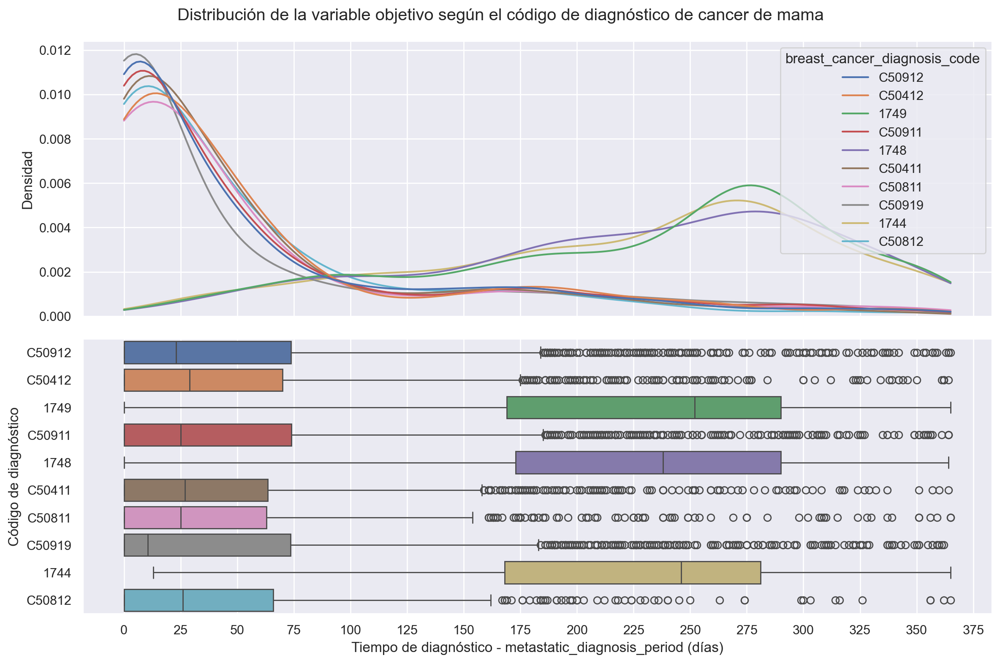

In [28]:
# Create the figures - sharing an X axis
fig, axs = plt.subplots(2, 1, 
                        figsize=(12, 8),
                        sharex=True);


# FIGURE 1 - KDE plot (density distribution)
sns.kdeplot(
    data=df_breast_cancer_diagnosis[df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"].isin(df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"].value_counts().nlargest(10).index)],
    x="metastatic_diagnosis_period",
    hue="breast_cancer_diagnosis_code",
    common_norm=False,
    clip=(0, df_payer_type["metastatic_diagnosis_period"].max()),
    ax=axs[0]
);
axs[0].set(ylabel="Densidad")

# FIGURE 2 - Box plot (distribution of values)
sns.boxplot(
    data=df_breast_cancer_diagnosis[df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"].isin(df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"].value_counts().nlargest(10).index)],
    y="breast_cancer_diagnosis_code",
    hue="breast_cancer_diagnosis_code",
    x="metastatic_diagnosis_period",
    ax=axs[1]
);
axs[1].set(ylabel="Código de diagnóstico",
           xlabel="Tiempo de diagnóstico - metastatic_diagnosis_period (días)")
axs[1].set_xticks(range(0, 400, 25));

# Add a title to the figure
plt.suptitle("Distribución de la variable objetivo según el código de diagnóstico de cancer de mama")

# Show the figure
plt.tight_layout();
plt.show();

En esta gráfica se observa algo inesperado: si bien es cierto que la ubicación del cancer puede influir en el valor promedio del tiempo de diagnóstico, **lo que más influye es el formato usado para escribir el código**:
- Los códigos siguiendo el estandar **ICD-9** (hasta 5 cifras, sin empezar por C) tienen **tiempos de diagnóstico muy elevados en promedio**, alrededor de los 250 días.
- En cambio, los códigos siguiendo el estandar **ICD-10** (hasta 7 cifras, empezando por C) tienen **tiempos de diagnóstico mas bajos** - alrededor de los 25 días, con algunos estando más cerca de los diez días.

Si bien no hay una razón obvia para esto, se puede especular con **la fecha de los diagnósticos**: el estándar ICD-9 se dejó de utilizar en el año 1999, lo que puede significar que los casos etiquetados con este estándar son casos más antiguos - y, por ende, **se disponían de menos recursos y conocimientos para el diagnóstico de la metástasis**.

Es de interés estudiar también el comportamiento de los tipos de cancer menos frecuentes. Ahora bien, al no poder representarse adecuadamente en un diagrama de cajas, se opta por observar manualmente si existe alguna relación:

In [29]:
# Entries belonging to codes with 5 or less instances
n_entries = 5
df_breast_cancer_diagnosis_infrequent = (
    df_breast_cancer_diagnosis[df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"].isin(
        df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"].value_counts()[(df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"].value_counts() <= n_entries)].index
    )].sort_values(by="breast_cancer_diagnosis_code")
)


print(f"Tiempo de diagnóstico promedio: {df_breast_cancer_diagnosis_infrequent['metastatic_diagnosis_period'].mean()}")
print(f"\tstd: {df_breast_cancer_diagnosis_infrequent['metastatic_diagnosis_period'].std()}")
display((
    df_breast_cancer_diagnosis_infrequent.groupby(["breast_cancer_diagnosis_code", "breast_cancer_diagnosis_desc"]).agg({"metastatic_diagnosis_period": ["count", "mean", "std"]})
))

Tiempo de diagnóstico promedio: 72.77272727272727
	std: 86.31886171310352


metastatic_diagnosis_period  \
                                                                                                      count   
breast_cancer_diagnosis_code breast_cancer_diagnosis_desc                                                     
C5001                        Malignant neoplasm of nipple and areola, female                              1   
C5011                        Malignant neoplasm of central portion of breast...                           3   
C50122                       Malignant neoplasm of central portion of left m...                           1   
C50221                       Malig neoplasm of upper-inner quadrant of right...                           1   
C5031                        Malignant neoplasm of lower-inner quadrant of b...                           4   
C5041                        Malignant neoplasm of upper-outer quadrant of b...                           5   
C50421                       Malig neoplasm of upper-outer quadrant of right...                           1   
C50619                       Malignant neoplasm of axillary tail of unsp fem...                           1   
C509                         Malignant neoplasm of breast of unspecified site                             4   
C50922                       Malignant neoplasm of unspecified site of left ...                           1   

                                                                                             \
                                                                                       mean   
breast_cancer_diagnosis_code breast_cancer_diagnosis_desc                                     
C5001                        Malignant neoplasm of nipple and areola, female      42.000000   
C5011                        Malignant neoplasm of central portion of breast...   30.333333   
C50122                       Malignant neoplasm of central portion of left m...  256.000000   
C50221                       Malig neoplasm of upper-inner quadrant of right...   93.000000   
C5031                        Malignant neoplasm of lower-inner quadrant of b...   44.000000   
C5041                        Malignant neoplasm of upper-outer quadrant of b...   56.800000   
C50421                       Malig neoplasm of upper-outer quadrant of right...    7.000000   
C50619                       Malignant neoplasm of axillary tail of unsp fem...    0.000000   
C509                         Malignant neoplasm of breast of unspecified site    148.500000   
C50922                       Malignant neoplasm of unspecified site of left ...   58.000000   

                                                                                             
                                                                                        std  
breast_cancer_diagnosis_code breast_cancer_diagnosis_desc                                    
C5001                        Malignant neoplasm of nipple and areola, female            NaN  
C5011                        Malignant neoplasm of central portion of breast...   15.307950  
C50122                       Malignant neoplasm of central portion of left m...         NaN  
C50221                       Malig neoplasm of upper-inner quadrant of right...         NaN  
C5031                        Malignant neoplasm of lower-inner quadrant of b...   44.996296  
C5041                        Malignant neoplasm of upper-outer quadrant of b...   92.893487  
C50421                       Malig neoplasm of upper-outer quadrant of right...         NaN  
C50619                       Malignant neoplasm of axillary tail of unsp fem...         NaN  
C509                         Malignant neoplasm of breast of unspecified site    112.120471  
C50922                       Malignant neoplasm of unspecified site of left ...         NaN

A simple vista, no parece haber una correlación significativa entre los distintos tipos - incluso dentro de los cánceres con más de una instancia parece haber **una gran desviación entre los valores**. 

Se puede comprobar también mediante tests si **existe una diferencia estadísticamente significativa** en el tiempo de diagnóstico dependiendo del tipo de cancer original. Para esto, se plantea un **test de hipótesis** con un **nivel de significación del 95%** ($\alpha=0.05$):

- $H_0$: La media del tiempo de diagnóstico es igual para todos los tipos de cancer.
- $H_1$: La media del tiempo de diagnóstico es **distinta** en alguno de los tipos.

In [30]:
# NON - GROUPED
# ANOVA (parametric test)
breast_cancer_diagnosis_anova = f_oneway(*[df_breast_cancer_diagnosis[df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"]==cancer_type]["metastatic_diagnosis_period"].to_list() 
                              for cancer_type in df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"].unique()])

# Kruskal-Wallis (non-parametric)
breast_cancer_diagnosis_kruskal = kruskal(*[df_breast_cancer_diagnosis[df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"]==cancer_type]["metastatic_diagnosis_period"].to_list() 
                              for cancer_type in df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"].unique()])

categorical_p_values["breast_cancer_diagnosis"] = {
    "anova": breast_cancer_diagnosis_anova[1],
    "kruskal": breast_cancer_diagnosis_kruskal[1]
}

# GROUPED
# Transform diagnosis code not in the top 10 into a separate group
df_breast_cancer_diagnosis_grouped = (
    df_breast_cancer_diagnosis.replace({
        "breast_cancer_diagnosis_code": (df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"].value_counts().sort_values(ascending=False).iloc[10:].index)
    }, value="OTHER")
)
# ANOVA (parametric test)
breast_cancer_diagnosis_grouped_anova = f_oneway(*[df_breast_cancer_diagnosis_grouped[df_breast_cancer_diagnosis_grouped["breast_cancer_diagnosis_code"]==cancer_type]["metastatic_diagnosis_period"].to_list() 
                              for cancer_type in df_breast_cancer_diagnosis_grouped["breast_cancer_diagnosis_code"].unique()])

# Kruskal-Wallis (non-parametric)
breast_cancer_diagnosis_grouped_kruskal = kruskal(*[df_breast_cancer_diagnosis_grouped[df_breast_cancer_diagnosis["breast_cancer_diagnosis_code"]==cancer_type]["metastatic_diagnosis_period"].to_list() 
                              for cancer_type in df_breast_cancer_diagnosis_grouped["breast_cancer_diagnosis_code"].unique()])

categorical_p_values["breast_cancer_diagnosis_grouped"] = {
    "anova": breast_cancer_diagnosis_grouped_anova[1],
    "kruskal": breast_cancer_diagnosis_grouped_kruskal[1]
}


print("P-Valores (sin agrupar):")
print(f"\t- ANOVA: {categorical_p_values['breast_cancer_diagnosis']['anova']}")
print(f"\t- Kruskal-Wallis: {categorical_p_values['breast_cancer_diagnosis']['kruskal']}")

print("P-Valores (top 10 + agrupación del resto):")
print(f"\t- ANOVA: {categorical_p_values['breast_cancer_diagnosis_grouped']['anova']}")
print(f"\t- Kruskal-Wallis: {categorical_p_values['breast_cancer_diagnosis_grouped']['kruskal']}")

P-Valores (sin agrupar):
	- ANOVA: 0.0
	- Kruskal-Wallis: 0.0
P-Valores (top 10 + agrupación del resto):
	- ANOVA: 0.0
	- Kruskal-Wallis: nan


Como se observa en los p-valores, **los p-valores son tan pequeños que acaban siendo representados como 0.0** - por lo que se puede **rechazar la hipótesis nula**.

Los valores de estas variables son **muy significativos** para la estimación posterior - pero, al representar la misma información, **es suficiente con utilizar unicamente uno de los dos atributos**.

### - **Códigos de diagnóstico de la metástasis (`metastatic_cancer_diagnosis_code`)**

En esta ocasión, el conjunto de datos no incluye la descripción textual de cada código.

In [31]:
df_metastatic_cancer_diagnosis = df_metastasis[["metastatic_cancer_diagnosis_code", "metastatic_diagnosis_period"]]
print(f"Número de códigos: {df_metastatic_cancer_diagnosis['metastatic_cancer_diagnosis_code'].nunique()}")

Número de códigos: 43


**43 códigos** sigue siendo un número muy elevado de posibles valores para el atributo - y, de nuevo, **no es un número exhaustivo**, por lo que pueden haber posibles valores no incluidos en el conjunto de entrenamiento.

Representando la distribución de instancias según el código:

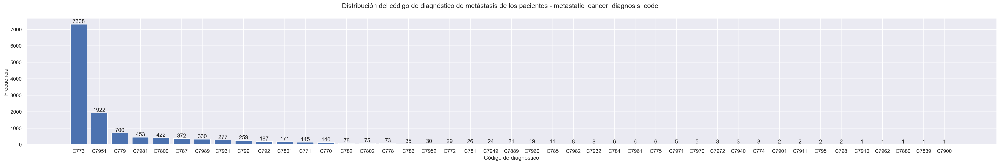

In [32]:
# Create the figure
fig = plt.figure(figsize=(30, 5));

# Create the barchart
plt.bar(x=df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"].value_counts().index,
        height=df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"].value_counts());
plt.bar_label(fig.gca().containers[0]);
plt.xlabel("Código de diagnóstico");
plt.ylabel("Frecuencia");
plt.suptitle("Distribución del código de diagnóstico de metástasis de los pacientes - metastatic_cancer_diagnosis_code");

# Show the figure
plt.tight_layout();
plt.show();

A diferencia del código de diagnóstico del cancer de mama, en este caso **hay un código que prepondera** respecto al resto (`C773`), aunque hay otros códigos con bastante ocurrencia.

Si se busca de forma externa el significado de los **diez códigos más frecuentes** - utilizando la web **`icd10data`** como referencia:
- `C773`: Metástasis en los **nodos linfáticos auxiliares y de las extremidades superiores**.
- `C7951`:Metástasis en los **huesos**.
- `C779`: Metástasis en **nodos linfáticos sin determinar**.
- `C7981`: Metástasis en **los pechos**.
- `C7800`: Metástasis en un **pulmón sin determinar**.
- `C787`: Metástasis en el **hígado y vesícula biliar**.
- `C7989`: Metástasis en **otra región especificada**.
- `C7931`: Metástasis en el **cerebro**.
- `C799`: Metástasis en **una zona sin especificar**.
- `C792`: Metástasis en la **piel**.

Todos los códigos utilizados hacen referencias a **neoplasmas secundarios malignos** (metástasis, en general debidas al tratamiento del cancer original). La mayoría de los casos tienen metástasis en regiones del **torso y extremidades superiores** - una evolución razonable de un cancer ubicado en las mamas.

Si se observa la distribución del tiempo de diagnóstico en base a estos códigos, fijandonos en los **diez códigos más frecuentes**:

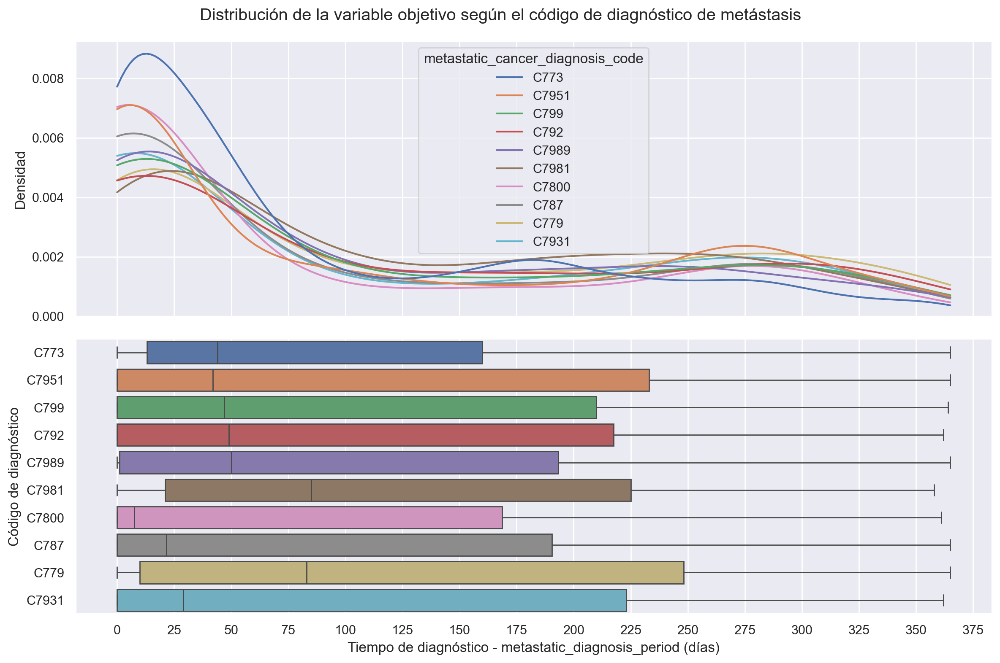

In [33]:
# Create the figures - sharing an X axis
fig, axs = plt.subplots(2, 1, 
                        figsize=(12, 8),
                        sharex=True);


# FIGURE 1 - KDE plot (density distribution)
sns.kdeplot(
    data=df_metastatic_cancer_diagnosis[df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"].isin(df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"].value_counts().nlargest(10).index)],
    x="metastatic_diagnosis_period",
    hue="metastatic_cancer_diagnosis_code",
    common_norm=False,
    clip=(0, df_payer_type["metastatic_diagnosis_period"].max()),
    ax=axs[0]
);
axs[0].set(ylabel="Densidad")

# FIGURE 2 - Box plot (distribution of values)
sns.boxplot(
    data=df_metastatic_cancer_diagnosis[df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"].isin(df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"].value_counts().nlargest(10).index)],
    y="metastatic_cancer_diagnosis_code",
    hue="metastatic_cancer_diagnosis_code",
    x="metastatic_diagnosis_period",
    ax=axs[1]
);
axs[1].set(ylabel="Código de diagnóstico",
           xlabel="Tiempo de diagnóstico - metastatic_diagnosis_period (días)")
axs[1].set_xticks(range(0, 400, 25));

# Add a title to the figure
plt.suptitle("Distribución de la variable objetivo según el código de diagnóstico de metástasis")

# Show the figure
plt.tight_layout();
plt.show();

Si bien es cierto que la diferencia no es tan pronunciada como en el caso del código de diagnóstico original, **el código de diagnóstico de la metástasis** - y, por ende, el tipo de metástasis - parece afectar sustancialmente a la distribución de los tiempos de diagnóstico. 

Ahora bien, no parece haber una correlación clara entre la ubicación de la metástasis y el tiempo de diagnóstico. Como ejemplo, las metástasis que más tiempo se tarda en diagnosticar en promedio son las metástasis en **las mamas** (`C79.81`) y **en nodos linfáticos indeterminados** (`C77.9`) - mientras que las metástasis en los nodos linfáticos superiores (`C77.3`), una región aparentemente cercana, tienen un tiempo de diagnóstico notablemente inferior.

Una vez más, es de interés estudiar también el comportamiento de los tipos de metástasis menos frecuentes. Ahora bien, al no poder representarse adecuadamente en un diagrama de cajas, se opta por observar manualmente si existe alguna relación:

In [34]:
# Entries belonging to codes with 5 or less instances
n_entries = 5
df_metastatic_cancer_diagnosis_infrequent = (
    df_metastatic_cancer_diagnosis[df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"].isin(
        df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"].value_counts()[(df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"].value_counts() <= n_entries)].index
    )].sort_values(by="metastatic_cancer_diagnosis_code")
)


print(f"Tiempo de diagnóstico promedio: {df_metastatic_cancer_diagnosis_infrequent['metastatic_diagnosis_period'].mean()}")
print(f"\tstd: {df_metastatic_cancer_diagnosis_infrequent['metastatic_diagnosis_period'].std()}")
display((
    df_metastatic_cancer_diagnosis_infrequent.groupby("metastatic_cancer_diagnosis_code").agg({"metastatic_diagnosis_period": ["count", "mean", "std"]})
))

Tiempo de diagnóstico promedio: 84.0625
	std: 108.54936070598214


metastatic_diagnosis_period              \
                                                       count        mean   
metastatic_cancer_diagnosis_code                                           
C774                                                       3  102.000000   
C7839                                                      1   27.000000   
C7880                                                      1    0.000000   
C7900                                                      1    0.000000   
C7901                                                      2  199.500000   
C7910                                                      1    0.000000   
C7911                                                      2  151.000000   
C7940                                                      3  106.333333   
C795                                                       2  150.000000   
C7962                                                      1  165.000000   
C7970                                                      5   88.200000   
C7971                                                      5   39.600000   
C7972                                                      3   34.666667   
C798                                                       2   64.500000   

                                              
                                         std  
metastatic_cancer_diagnosis_code              
C774                               45.310043  
C7839                                    NaN  
C7880                                    NaN  
C7900                                    NaN  
C7901                             214.253355  
C7910                                    NaN  
C7911                             181.019336  
C7940                             178.146943  
C795                              212.132034  
C7962                                    NaN  
C7970                             121.982376  
C7971                              62.199678  
C7972                              28.095077  
C798                               40.305087

A simple vista, no parece haber una correlación significativa entre los distintos tipos - incluso dentro de las metástasis con más de una instancia parece haber **una gran desviación entre los valores**. 

Se puede comprobar también mediante tests si **existe una diferencia estadísticamente significativa** en el tiempo de diagnóstico dependiendo del tipo de metástasis. Para esto, se plantea un **test de hipótesis** con un **nivel de significación del 95%** ($\alpha=0.05$):

- $H_0$: La media del tiempo de diagnóstico es igual para todos los tipos de metástasis.
- $H_1$: La media del tiempo de diagnóstico es **distinta** en alguno de los tipos.

In [35]:
# NON GROUPED
# ANOVA (parametric test)
metastatic_cancer_diagnosis_anova = f_oneway(*[df_metastatic_cancer_diagnosis[df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"]==metastatic_type]["metastatic_diagnosis_period"].to_list() 
                              for metastatic_type in df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"].unique()])

# Kruskal-Wallis (non-parametric)
metastatic_cancer_diagnosis_kruskal = kruskal(*[df_metastatic_cancer_diagnosis[df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"]==metastatic_type]["metastatic_diagnosis_period"].to_list() 
                              for metastatic_type in df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"].unique()])

categorical_p_values["metastatic_cancer_diagnosis"] = {
    "anova": metastatic_cancer_diagnosis_anova[1],
    "kruskal": metastatic_cancer_diagnosis_kruskal[1]
}

# GROUPED
# Transform diagnosis code not in the top 10 into a separate group
df_metastatic_cancer_diagnosis_grouped = (
    df_metastatic_cancer_diagnosis.replace({
        "metastatic_cancer_diagnosis_code": (df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"].value_counts().sort_values(ascending=False).iloc[10:].index)
    }, value="OTHER")
)
# ANOVA (parametric test)
metastatic_cancer_diagnosis_grouped_anova = f_oneway(*[df_metastatic_cancer_diagnosis_grouped[df_metastatic_cancer_diagnosis_grouped["metastatic_cancer_diagnosis_code"]==metastatic_type]["metastatic_diagnosis_period"].to_list() 
                              for metastatic_type in df_metastatic_cancer_diagnosis_grouped["metastatic_cancer_diagnosis_code"].unique()])

# Kruskal-Wallis (non-parametric)
metastatic_cancer_diagnosis_grouped_kruskal = kruskal(*[df_metastatic_cancer_diagnosis_grouped[df_metastatic_cancer_diagnosis["metastatic_cancer_diagnosis_code"]==metastatic_type]["metastatic_diagnosis_period"].to_list() 
                              for metastatic_type in df_metastatic_cancer_diagnosis_grouped["metastatic_cancer_diagnosis_code"].unique()])

categorical_p_values["metastatic_cancer_diagnosis_grouped"] = {
    "anova": metastatic_cancer_diagnosis_grouped_anova[1],
    "kruskal": metastatic_cancer_diagnosis_grouped_kruskal[1]
}

print("P-Valores (sin agrupar):")
print(f"\t- ANOVA: {categorical_p_values['metastatic_cancer_diagnosis']['anova']}")
print(f"\t- Kruskal-Wallis: {categorical_p_values['metastatic_cancer_diagnosis']['kruskal']}")

print("P-Valores (top 10 + agrupación del resto):")
print(f"\t- ANOVA: {categorical_p_values['metastatic_cancer_diagnosis_grouped']['anova']}")
print(f"\t- Kruskal-Wallis: {categorical_p_values['metastatic_cancer_diagnosis_grouped']['kruskal']}")

P-Valores (sin agrupar):
	- ANOVA: 5.118609299376007e-22
	- Kruskal-Wallis: 1.3332096851383465e-21
P-Valores (top 10 + agrupación del resto):
	- ANOVA: 2.6111144324447535e-29
	- Kruskal-Wallis: nan


Como era de esperar tras observar las distribuciones en las gráficas, los p-valores nos permiten **rechazar la hipótesis nula**. Por tanto, el tipo de metástasis parece ser **una variable de gran importancia** a la hora de estimar el tiempo que se tarda en realizar el diagnóstico.

### - **Género (`patient_gender`)**

En el caso de esta variable, no hay ningún valor perdido. Ahora bien:

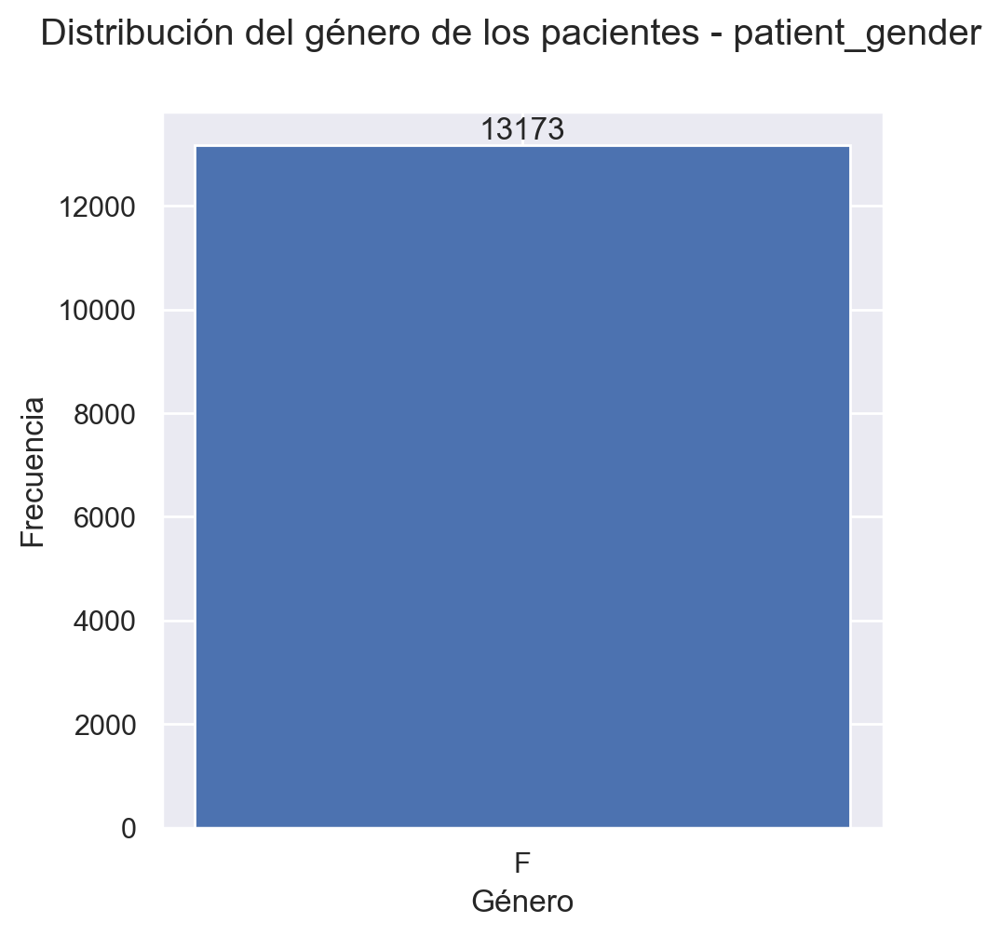

In [36]:
# Create the figure
fig = plt.figure(figsize=(5, 5));

# Create the barchart
plt.bar(x=df_metastasis["patient_gender"].value_counts().index,
        height=df_metastasis["patient_gender"].value_counts());
plt.bar_label(fig.gca().containers[0]);
plt.xlabel("Género");
plt.ylabel("Frecuencia");
plt.suptitle("Distribución del género de los pacientes - patient_gender");

**Todas las instancias tienen el mismo valor de la variable** - todas las instancias se corresponden a mujeres. Por lo tanto, **el atributo no tiene ningún poder discriminador**, y se puede descartar a la hora de construir modelos.

*(**NOTA**: Como se ha observado previamente, existen cuatro instancias cuyo diagnóstico de cancer hace referencia a cancer en hombres, pero el gran sesgo de la variable seguiría haciendo que fuese muy poco util de cara a la creación de modelos de regresión posteriores)*

### - **Tipos de tratamiento (`metastatic_first_novel_treatment`, `metastatic_first_novel_treatment_type`)**

Como se vio durante el estudio de valores perdidos, **la amplia mayoría de los valores de estas variables son desconocidos**. Esto puede deberse a que, según la descripción de la variable, este atributo hace referencia al tratamiento utilizado **tras el diagnóstico** - lo que puede significar que aún no está asignado o reflejado en el conjunto de datos.

Para visualización, se marcarán temporalmente con el valor `UNKNOWN`:

In [37]:
df_metastatic_first_novel_treatment = df_metastasis[["metastatic_first_novel_treatment", "metastatic_first_novel_treatment_type"]].fillna("UNKNOWN")
print(f"Número de valores: {len(df_metastatic_first_novel_treatment[df_metastatic_first_novel_treatment['metastatic_first_novel_treatment'] != 'UNKNOWN'])}")

Número de valores: 11


Si se observa la distribución de los valores de la variable:

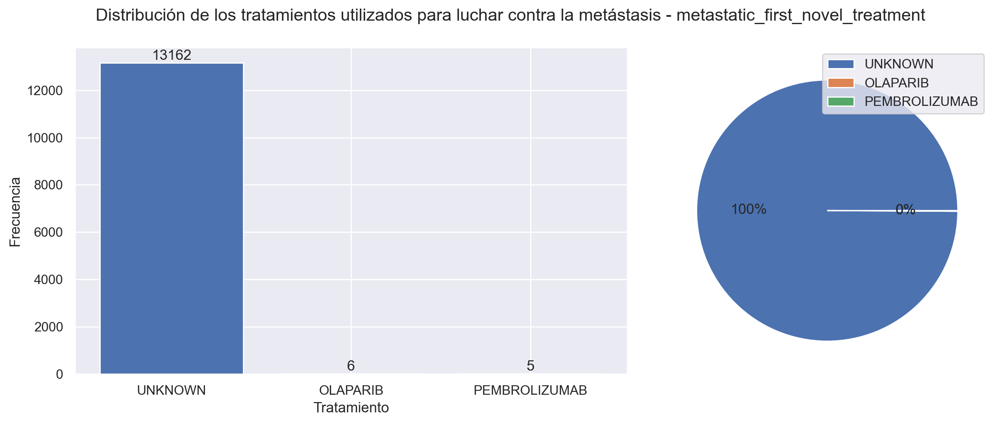

In [38]:
# Create the figure
fig, axs = plt.subplots(1, 2, 
                        figsize=(12, 5),
                        width_ratios=[1.5, 1]);

# FIGURE 1: Bar chart
axs[0].bar(x=df_metastatic_first_novel_treatment["metastatic_first_novel_treatment"].value_counts().index,
           height=df_metastatic_first_novel_treatment["metastatic_first_novel_treatment"].value_counts());
axs[0].bar_label(axs[0].containers[0]);
axs[0].set(xlabel="Tratamiento",
           ylabel="Frecuencia")

# FIGURE 2: Pie plot
axs[1].pie(x=df_metastatic_first_novel_treatment["metastatic_first_novel_treatment"].value_counts(),
           autopct="%1.f%%");
axs[1].legend(df_metastatic_first_novel_treatment["metastatic_first_novel_treatment"].value_counts().index);

# Add a title to the figure
fig.suptitle("Distribución de los tratamientos utilizados para luchar contra la metástasis - metastatic_first_novel_treatment")

# Show the figure
plt.tight_layout();
plt.show();

Como se puede ver, **únicamente 11 de las instancias tienen un valor conocido para la variable**. Con esta gran cantidad de valores perdidos, **no tiene sentido considerar el atributo durante la creación de modelos** - al tener muy poco poder discriminatorio.

---

<a id="section2-4"></a>

## 2.4. Estudio de atributos numéricos

El primer paso, una vez más, consiste en comprobar las variables numéricas disponibles:

In [39]:
print("Atributos numéricos:")
display(
    df_numerical.describe().transpose()
)

Atributos numéricos:


,count,mean,std,min,25%,50%,75%,max
patient_age,13173.0,59.271313,13.218883,18.00,50.000,59.00,67.00,91.00
bmi,4102.0,29.168808,5.752820,15.00,24.825,28.58,33.00,97.00
population,13173.0,20651.373928,13840.379638,635.55,9160.340,18952.78,30021.28,71374.13
density,13173.0,1776.872376,3876.061897,0.92,163.150,700.34,1666.52,29851.69
age_median,13173.0,40.542676,4.031027,20.60,37.190,40.64,42.94,54.57
...,...,...,...,...,...,...,...,...
Average of Sep-18,13166.0,71.417027,6.502875,51.83,67.020,70.88,75.64,89.19
Average of Oct-18,13166.0,59.323286,9.261934,37.54,51.970,57.45,67.36,81.46
Average of Nov-18,13161.0,46.100150,12.245594,19.15,35.560,42.43,55.73,76.30
Average of Dec-18,13140.0,42.096213,11.209011,15.38,33.370,38.50,50.50,73.54


En total hay **139 variables numéricas** - concretamente **138 atributos** y la **variable objetivo** -, por lo que realizar un estudio exhaustivo de todas las variables es imposible.

Además, existe una **correlación inmediata** entre muchos de estos atributos:
- Salvo las dos siguientes variables - que son específicas para cada paciente -, el resto de variables **no dependen del paciente, sino del código zip del paciente**:
    - `bmi` - índice de masa corporal.
    - `patient_age` - edad del paciente.
- Las variables que dependen del código zip **tienen siempre los mismos valores para el mismo código zip** - por lo que **toda su información estaría codificada directamente en el código zip**.

### **- Estudio de correlación entre las variables**

Primero, se va a estudiar la **correlación entre variables**. A partir de estas correlaciones, **se estudiarán los pares de variables con correlaciones más fuertes**.

In [40]:
df_numerical_corrs = df_numerical.corr()
display(df_numerical_corrs.style.background_gradient())

La matriz de correlaciones es demasiado extensa como para estudiarla a simple vista, pero se puede observar de un vistazo que **hay una correlación fuerte entre las variables de temperatura**. Esto es de esperar: las temperaturas son similares entre meses contiguos, y en el mismo mes en distintos años.

Mostrando la misma tabla, pero ignorando los valores de temperaturas:

In [41]:
df_numerical_corrs_no_temps = df_numerical_corrs.loc[~df_numerical_corrs.columns.str.startswith("Average"), ~df_numerical_corrs.columns.str.startswith("Average")]
display(df_numerical_corrs_no_temps.style.background_gradient())

,patient_age,bmi,population,density,age_median,age_under_10,age_10_to_19,age_20s,age_30s,age_40s,age_50s,age_60s,age_70s,age_over_80,male,female,married,divorced,never_married,widowed,family_size,family_dual_income,income_household_median,income_household_under_5,income_household_5_to_10,income_household_10_to_15,income_household_15_to_20,income_household_20_to_25,income_household_25_to_35,income_household_35_to_50,income_household_50_to_75,income_household_75_to_100,income_household_100_to_150,income_household_150_over,income_household_six_figure,income_individual_median,home_ownership,housing_units,home_value,rent_median,rent_burden,education_less_highschool,education_highschool,education_some_college,education_bachelors,education_graduate,education_college_or_above,education_stem_degree,labor_force_participation,unemployment_rate,self_employed,farmer,race_white,race_black,race_asian,race_native,race_pacific,race_other,race_multiple,hispanic,disabled,poverty,limited_english,commute_time,health_uninsured,veteran,metastatic_diagnosis_period
patient_age,1.000000,-0.064353,-0.015176,0.006531,0.030314,-0.032271,-0.021923,-0.009211,-0.017781,-0.019055,0.017044,0.027338,0.015984,0.045055,-0.015708,0.015690,-0.015185,0.017213,0.008421,0.006647,-0.050301,0.009868,-0.028867,-0.014103,0.016649,0.001683,0.004094,0.001336,0.016743,0.028890,0.039810,0.032531,-0.002780,-0.031913,-0.026637,-0.021960,0.026011,-0.006742,-0.042805,-0.040364,-0.007376,-0.058932,0.023743,0.024322,-0.002933,0.000046,-0.001536,-0.014651,0.006793,-0.009016,-0.034077,-0.001734,0.032846,0.001156,-0.031830,0.001835,-0.021131,-0.042141,-0.035176,-0.040543,0.010104,-0.007361,-0.025772,-0.036683,-0.053137,-0.013534,-0.055231
bmi,-0.064353,1.000000,-0.049650,-0.058784,-0.015282,0.045165,0.037847,0.003655,-0.040773,-0.045024,-0.013986,0.017862,-0.000909,-0.019780,-0.007370,0.007371,-0.008429,0.056547,-0.016577,0.049383,-0.003512,-0.074490,-0.105624,0.027259,0.045554,0.057909,0.075732,0.078302,0.098801,0.109676,0.080355,0.029396,-0.066352,-0.110260,-0.107229,-0.113294,0.049148,-0.052401,-0.133352,-0.114775,-0.000074,0.039505,0.101624,0.048330,-0.108291,-0.097797,-0.106975,-0.068648,-0.057746,0.027592,-0.082807,0.045571,0.028940,0.053418,-0.101165,-0.034376,-0.042655,-0.039278,-0.041148,-0.022928,0.071946,0.052728,-0.049177,-0.022948,0.044871,0.043467,-0.018914
population,-0.015176,-0.049650,1.000000,0.619621,-0.561744,0.235991,-0.019905,0.449010,0.643747,0.396490,-0.393759,-0.656251,-0.541863,-0.306340,-0.308368,0.308292,-0.455749,-0.349978,0.603883,-0.486493,0.471998,0.337002,0.305003,0.202164,0.014172,-0.042486,-0.246270,-0.307420,-0.381546,-0.429899,-0.477053,-0.318618,0.123797,0.446534,0.397058,0.336877,-0.727942,0.980959,0.564443,0.640018,0.435424,0.266485,-0.620081,-0.449952,0.523380,0.445201,0.503151,0.255421,0.427439,0.280122,0.509707,-0.534379,-0.735073,0.305640,0.592408,-0.068336,0.054776,0.626993,0.483859,0.542499,-0.531929,0.116850,0.677193,0.469688,0.051160,-0.501524,0.010020
density,0.006531,-0.058784,0.619621,1.000000,-0.293487,-0.011341,-0.268442,0.303005,0.551405,0.200260,-0.260775,-0.368071,-0.270585,-0.087067,-0.294734,0.294683,-0.417598,-0.270492,0.499889,-0.233280,0.145768,0.135420,0.179390,0.248591,0.158717,0.157096,-0.040396,-0.121653,-0.220936,-0.305266,-0.408719,-0.351735,-0.078070,0.299176,0.219946,0.347548,-0.675958,0.667001,0.510346,0.414260,0.227120,0.184912,-0.349021,-0.552933,0.357914,0.408755,0.396950,0.050875,0.227699,0.278189,0.412597,-0.247179,-0.473511,0.252624,0.378209,-0.051682,-0.006195,0.406737,0.129224,0.223542,-0.259759,0.191146,0.488978,0.479037,-0.124069,-0.463909,0.026263
age_median,0.030314,-0.015282,-0.561744,-0.293487,1.000000,-0.512249,-0.442669,-0.787362,-0.671198,-0.189304,0.689392,0.876703,0.889101,0.680052,0.127355,-0.127297,0.612848,0.223149,-0.741304,0.611491,-0.435892,-0.304211,-0.003224,-0.313079,-0.233281,-0.128392,0.041609,0.079270,0.129634,0.145281,0.201411,0.222968,0.067418,-0.114079,-0.073131,-0.071456,0.657230,-

Si bien la tabla de correlaciones sigue siendo demasiado grande para ser estudiada de forma cómoda, se pueden observar **correlaciones dentro de los grupos de variables relacionadas**.
- Por ejemplo, parece haber correlación entre todas las variables relacionadas con los **ingresos de la población**:
    - `income_household_median` - Mediana de los ingresos de la zona.
    - `income_household_six_figure`- Porcentaje de la población con un ingreso de $100.000 dolares o más.
    - `income_household_150_over` - Porcentaje de la población con ingresos de $150.000 dolares o más.
- Además, existe **correlación muy fuerte** entre variables binarias:
    - `male` y `female`: Al considerarse únicamente los dos géneros en las estadísticas, hay una correlación directa entre los valores - el porcentaje de la población que no es hombre es mujer.
    - `married` y `never_married`: Aunque no son exactamente opuestas (existe gente que se ha casado y luego divorciado), es de esperar la correlación entre la gente que nunca se ha casado y la gente que está casada.

Si se observan los valores de la tabla ordenados para ver los **quince pares de variables con más correlación**:

In [42]:
(
    df_numerical_corrs_no_temps.abs()                                                   # 1 - Obtain the absolute values
    .where(np.triu(np.ones(df_numerical_corrs_no_temps.shape), k=1).astype(bool))       # 2 - To avoid duplicate values, extract only the upper triangle of the table
    .stack()                                                                            # 3 - Convert the table into an array
    .sort_values(ascending=False)                                                       # 4 - Sort the values and extract the top n values
    .nlargest(15)
)

male                         female                         1.000000
population                   housing_units                  0.980959
income_household_median      income_household_six_figure    0.979312
income_household_150_over    income_household_six_figure    0.971842
education_bachelors          education_college_or_above     0.965783
income_household_median      income_household_150_over      0.964930
education_graduate           education_college_or_above     0.962566
married                      never_married                  0.928241
income_household_median      income_individual_median       0.914596
income_household_150_over    income_individual_median       0.910318
home_value                   rent_median                    0.906421
income_household_six_figure  income_individual_median       0.899902
age_median                   age_70s                        0.889101
income_household_150_over    rent_median                    0.888027
income_household_25_to_35    incom

Los pares obtenidos no ofrecen gran información - como se comentó al principio de la sección, **hay una fuerte correlación entre variables que representan a los mismos estadísticos** - siendo, por tanto, **variables redundantes** que no aportan gran poder discriminatorio.

---

Un análisis que puede resultar más util de cara a la creación de modelos es estudiar directamente la **correlación entre atributos y la variable objetivo** - para poder estudiar las variables que más influyen en el tiempo de espera para el diagnóstico.

Se observan las **veinte variables** - incluyendo las variables de temperatura - con correlaciones más fuertes:

In [43]:
top_corrs = df_numerical_corrs["metastatic_diagnosis_period"].drop("metastatic_diagnosis_period").abs().sort_values(ascending=False).nlargest(20)
display(top_corrs)

patient_age                   0.055231
labor_force_participation     0.039369
family_dual_income            0.036403
education_bachelors           0.033842
income_household_10_to_15     0.031975
Average of May-15             0.029484
poverty                       0.029135
widowed                       0.029086
income_household_15_to_20     0.028111
education_college_or_above    0.027753
family_size                   0.027333
income_household_under_5      0.026959
education_less_highschool     0.026777
income_household_75_to_100    0.026670
density                       0.026263
income_household_5_to_10      0.025621
race_black                    0.025422
unemployment_rate             0.025372
Average of Aug-16             0.024953
income_individual_median      0.024743
Name: metastatic_diagnosis_period, dtype: float64

En contra de lo que se podría esperar - y de lo que se observó con las variables categóricas -, **la práctica totalidad de las variables no parecen guardar ninguna correlación con la variable objetivo**. 
- La variable con una correlación más fuerte con la clase (`patient_age`) tiene un valor de $r=0.055$.
- La siguiente variable (`labor_force_participation`) baja su valor hasta $r=0.039$ aproximadamente.

Estas características se pueden observar mejor si se **representan gráficamente las distribuciones**:

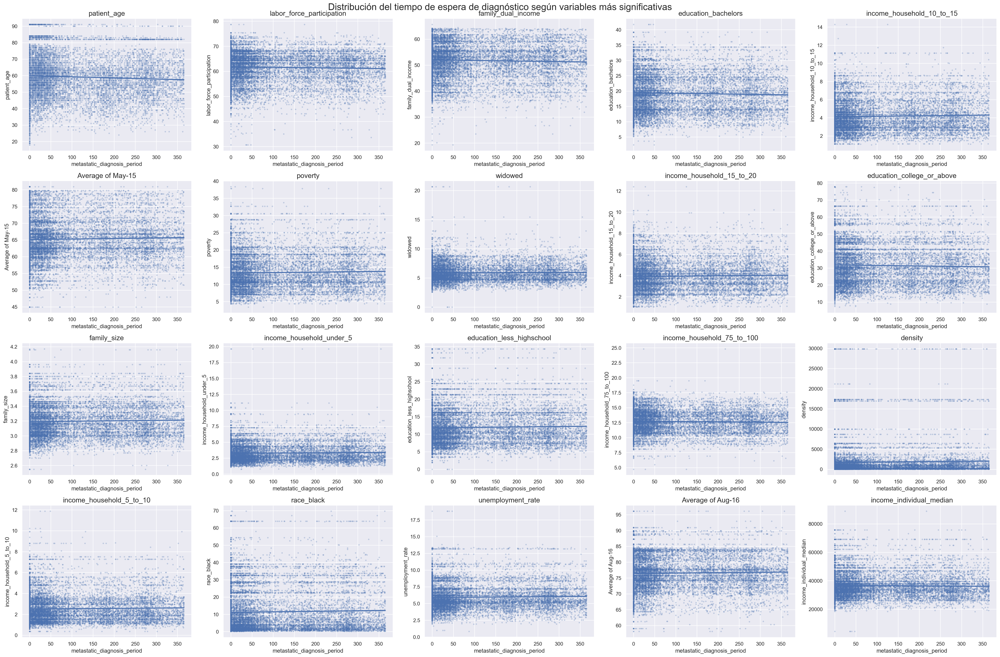

In [44]:
# Create the figures
fig, axs = plt.subplots(nrows=4, ncols=5, figsize=(30, 20));

# For each figure
for pos, variable in enumerate(top_corrs.index.to_list()):

    # Plot a regression graph
    sns.regplot(data= df_numerical[[variable, "metastatic_diagnosis_period"]],
                x="metastatic_diagnosis_period",
                y=variable,
                scatter_kws={"s":5, "alpha": 0.20},
                ax=axs[pos // 5][pos % 5])
    
    # Plot titles
    axs[pos // 5][pos % 5].set_title(variable, fontsize=15)

# Ensure that the layout has as little white space as available
plt.suptitle("Distribución del tiempo de espera de diagnóstico según variables más significativas", fontsize=20);
plt.tight_layout()

Tal y como mostraban los valores númericos de correlación, **no se pueden observar correlaciones claras entre los atributos y la variable objetivo**. En todos los casos se puede ver que los casos están distribuidos de forma uniforme a lo ancho de la gráfica - indicando que el valor del tiempo de diagnóstico no guarda relación alguna con el atributo.

### **- Variables médicas del paciente (`patient_age`, `bmi`)**

Pese a los resultados obtenidos en la sección anterior, se procede a realizar un estudio más pormenorizado de las variables propias de los pacientes - para estudiar sus valores perdidos, y si estos pueden afectar de alguna forma al tiempo necesario para el diagnóstico:
- `patient_age`.
- `bmi`.

Antes de estudiar individualmente cada variable, se observa una **matriz de correlación entre las variables y la clase**, y su representación gráfica:

,patient_age,bmi,metastatic_diagnosis_period
patient_age,1.000000,-0.064353,-0.055231
bmi,-0.064353,1.000000,-0.018914
metastatic_diagnosis_period,-0.055231,-0.018914,1.000000


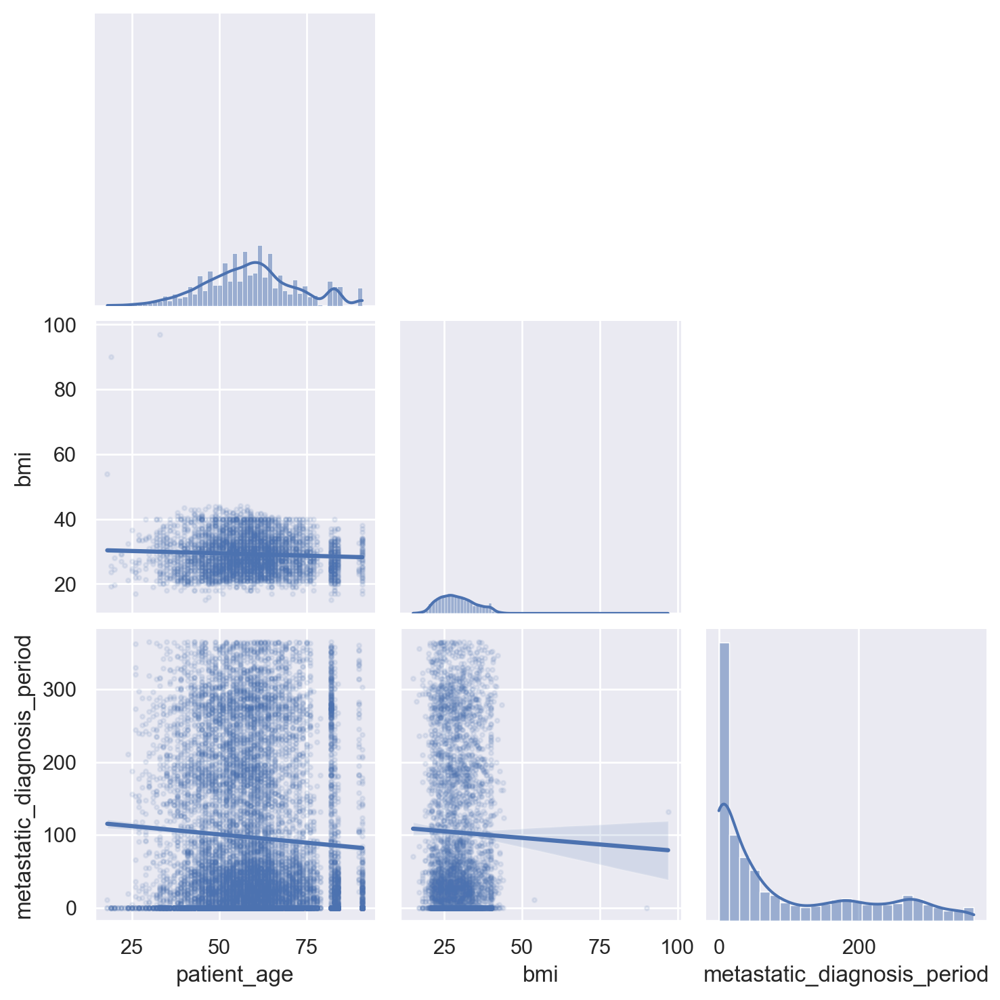

In [45]:
# Display a heatmap-colored correlation matrix
display(
    df_numerical[["patient_age", "bmi", "metastatic_diagnosis_period"]]
    .corr().style.background_gradient()
)

# Draw a pair plot where:
fig = sns.pairplot(df_numerical,
                   vars=["patient_age", "bmi", "metastatic_diagnosis_period"],  # Only the specified variables are used
                   kind="reg",                                                  # A regression plot (scatter + regression line) is used for variable correlations
                   corner=True,                                                 # Only display a triangle of the possible graphs
                   diag_kws={"kde": True},                                      # For the diagonal (monovariable distributions) display a histogram + KDE
                   plot_kws={"scatter_kws": {"s":5, "alpha": 0.10}})            # Make the points of the scatter plots smaller and translucent

Se puede observar que:
- **No existe una correlación entre el índice de masa corporal y la edad**.
    - Si bien puede parecer visualmente que hay cierta correlación, la gráfica está ampliada por los *valores extremos*. Sin ellos, se observaría que no hay una clara relación entre ambas variables.
- Como se observó en el apartado anterior, **no existe correlación entre los atributos y la variable objetivo**.

Para estudiar cada variable independiente, se van a comprobar sus interacciones con la clase y como pueden influir en ésta las siguientes variables categóricas:
- **Raza (`patient_race`)**: Sustituyendo los valores perdidos por `Unknown`.
- **Tipo de seguro médico (`payer_type`)**: Sustituyendo los valores perdidos por `UNKNOWN`.
- **Código de diagnóstico del cancer de mama (`breast_cancer_diagnosis_code`)**: Tomando los diez códigos más frecuentes y catalogando el resto como `OTHER`.
- **Código de diagnóstico de la metástasis (`metastatic_cancer_diagnosis_code`)**: Tomando los diez códigos más frecuentes y catalogando el resto como `OTHER`.

Para esto, se crea un subconjunto de datos con todas las transformaciones preparadas:

In [46]:
# Number of codes to keep
n_codes = 10
# Categorical variables to use
categorical_variables = ["patient_race", "payer_type", "breast_cancer_diagnosis_code", "metastatic_cancer_diagnosis_code"]

df_numerical_study = (
    # 1 - Keep only the relevant columns
    df_metastasis[categorical_variables + ["patient_age", "bmi", "metastatic_diagnosis_period"]]
    # 2 - Keep only the most frequent breast cancer and metastatic cancer diagnosis codes - grouping the rest into an OTHER category
    .replace({
        "breast_cancer_diagnosis_code": df_metastasis["breast_cancer_diagnosis_code"].value_counts().sort_values(ascending=False).iloc[n_codes:].index,
        "metastatic_cancer_diagnosis_code": df_metastasis["metastatic_cancer_diagnosis_code"].value_counts().sort_values(ascending=False).iloc[n_codes:].index
    }, value="OTHER")
    # 3 - Replace NaN values with "UNKNOWN" categories
    .fillna({"patient_race": "Unknown", "payer_type": "UNKNOWN"})
)

display(df_numerical_study.head(10))

,patient_race,payer_type,breast_cancer_diagnosis_code,metastatic_cancer_diagnosis_code,patient_age,bmi,metastatic_diagnosis_period
patient_id,,,,,,,
268700,Unknown,COMMERCIAL,C50912,C773,39,NaN,191
484983,White,UNKNOWN,C50412,C773,55,35.36,33
277055,Unknown,COMMERCIAL,1749,C773,59,NaN,157
320055,Hispanic,MEDICAID,C50911,C773,59,NaN,146
190386,Unknown,COMMERCIAL,1748,C7951,71,NaN,286
559027,Unknown,COMMERCIAL,1749,OTHER,63,NaN,73
293747,White,MEDICARE ADVANTAGE,C50412,C799,57,33.10,59
517596,White,COMMERCIAL,C50411,C792,56,31.05,316
533188,Unknown,COMMERCIAL,OTHER,C773,65,NaN,86


#### *- Edad (`patient_age`)*

El primer paso consiste en estudiar la **distribución de la variable**, junto a los **valores perdidos**:

Valores perdidos: 0


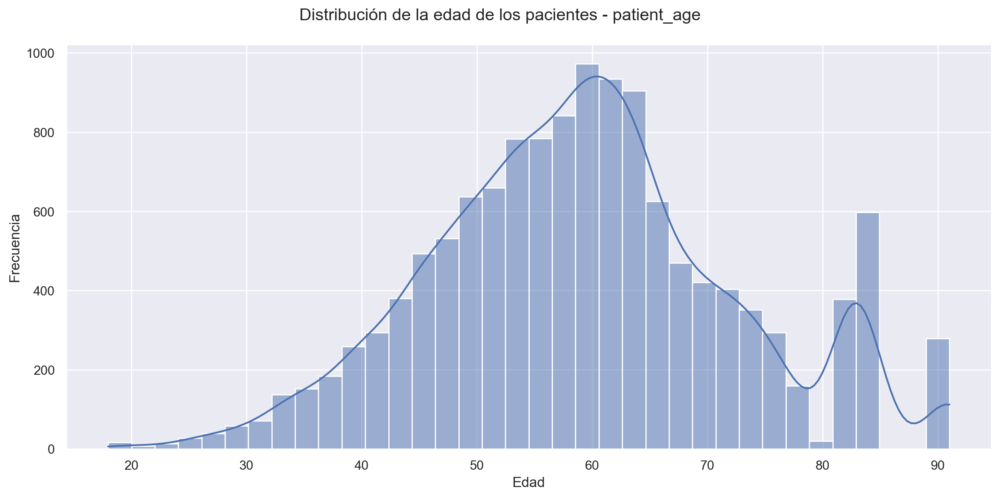

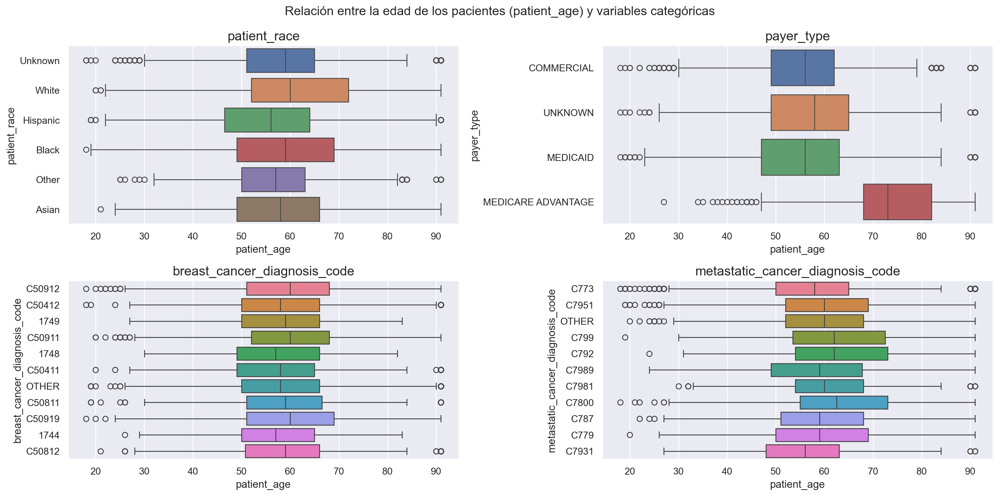

In [47]:
#Check the number of missing values
print(f"Valores perdidos: {df_numerical_study['patient_age'].isna().sum()}")

# AGE DISTRIBUTION
# Create a histogram plot describing the distribution of the figure
fig = plt.figure(figsize=(12, 6))
sns.histplot(data=df_numerical_study,
             x="patient_age",
             binwidth=2,
             kde=True);

# Set the axes and titles
plt.xlabel("Edad")
plt.ylabel("Frecuencia")
plt.suptitle("Distribución de la edad de los pacientes - patient_age")

plt.tight_layout();
plt.show();

fig, axs = plt.subplots(2, 2, figsize=(16, 8))

# AGE DISTRIBUTION ACCORDING TO CATEGORICAL VARIABLES
# Plot the distribution of the age, according to every categorical variable being studied
for pos, variable in enumerate(categorical_variables):
    
    # Create a box plot
    sns.boxplot(data=df_numerical_study,
                x="patient_age",
                y=variable,
                hue=variable,
                ax= axs[pos // 2][pos % 2])
    
    # Plot titles
    axs[pos // 2][pos % 2].set_title(variable, fontsize=15)

# Define the title and set a tight layour
plt.suptitle("Relación entre la edad de los pacientes (patient_age) y variables categóricas")
plt.tight_layout();
plt.show();

De las gráficas mostradas se puede extraer la siguiente información sobre la edad de los pacientes:

- **No existe ningún valor perdido para la variable** - se conoce la edad de todos los pacientes.
- La edad promedio está **alrededor de los 60 años** - siguiendo una distribución relativamente normal, con un pico adicional sobre los 80 años.
- Respecto a la correlación entre la edad y las variables categóricas:
    - Existe **una correlación clara entre la edad de los pacientes y el seguro médico que utilizan** - siendo la edad promedio de `Medicare Advantage` sustancialmente más elevada.
        - Este resultado es coherente - *Medicare Advantage* es un seguro médico específicamente para personas mayores de 65 años.
    - Para el resto de variables, **no existe una correlación tan fuerte** con la edad de los pacientes.

Estudiando, además, la **relación entre la edad de los pacientes y el tiempo de diagnóstico**:

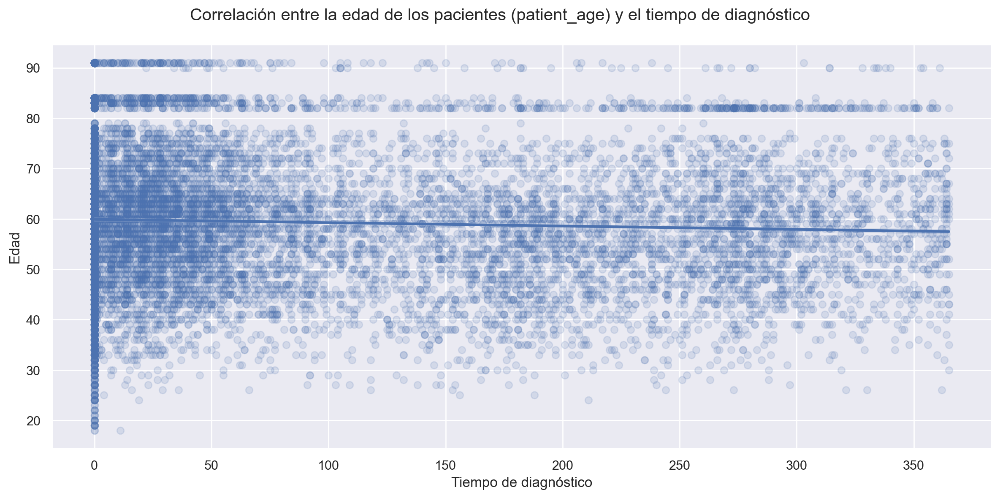

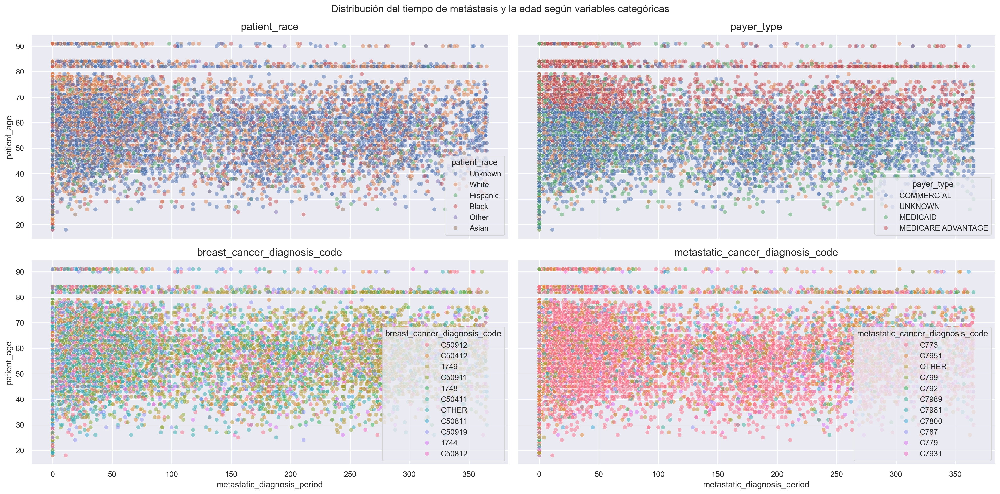

In [48]:
# CORRELATION BETWEEN AGE AND DIAGNOSIS TIME
# Create the figure
fig = plt.figure(figsize=(12, 6));

# Plot a regression figure showing the computed regression line
sns.regplot(data=df_numerical_study,
            x="metastatic_diagnosis_period",
            y="patient_age",
            scatter_kws={"alpha": 0.15});

# Modify the labels and titles
plt.suptitle("Correlación entre la edad de los pacientes (patient_age) y el tiempo de diagnóstico");
plt.xlabel("Tiempo de diagnóstico");
plt.ylabel("Edad")
plt.tight_layout();
plt.show();


# CORRELATION BETWEEN AGE AND DIAGNOSIS TIME - ACCORDING TO OTHER CATEGORICAL VARIABLES
# Create the figure
fig, axs = plt.subplots(2, 2, figsize=(20, 10), sharex=True, sharey=True);

# Plot the age of the patients according to each categorical variable
for pos, variable in enumerate(categorical_variables):
    
    # Create a scatterplot
    sns.scatterplot(data=df_numerical_study,
                x="metastatic_diagnosis_period",
                y="patient_age",
                hue=variable,
                alpha=0.5,
                ax= axs[pos // 2][pos % 2]);
    
    # Plot titles
    axs[pos // 2][pos % 2].set_title(variable, fontsize=15);

# Define the title and set a tight layout
plt.suptitle("Distribución del tiempo de metástasis y la edad según variables categóricas");
plt.tight_layout();
plt.show();

Tal y como se observó en las matrices de correlación, **no existe ninguna correlación entre la edad de los pacientes y el tiempo de diagnóstico promedio**:
- La mayoría de diagnósticos se encuentran en la franja de los **cero días** - independientemente de la edad.
- Salvo las edades más bajas - que son mucho menos frecuentes en el conjunto de datos, **los periodos de diagnóstico se distribuyen de forma uniforme para todas las edades**.
- Se observan huecos con menos diagnósticos alrededor de los **80 años** - correspondiendose con el **pico de pacientes de 80 años**, y los valles a cada lado.

Por tanto, **la edad del paciente no parece aportar información relevante a la hora de predecir el tiempo de diagnóstico**.

#### *- Indice de masa corporal (`bmi`)*

El primer paso consiste en estudiar la **distribución de la variable**, junto a los **valores perdidos**:

Valores perdidos: 9071


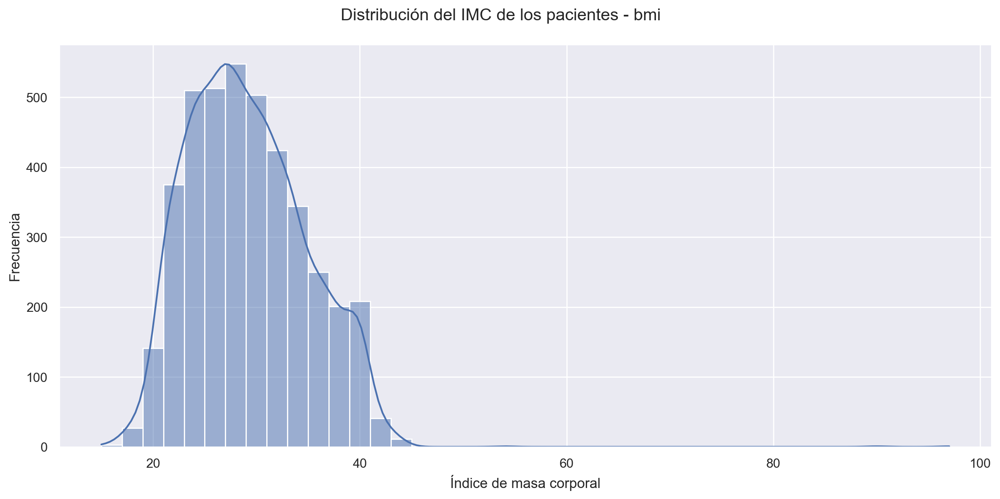

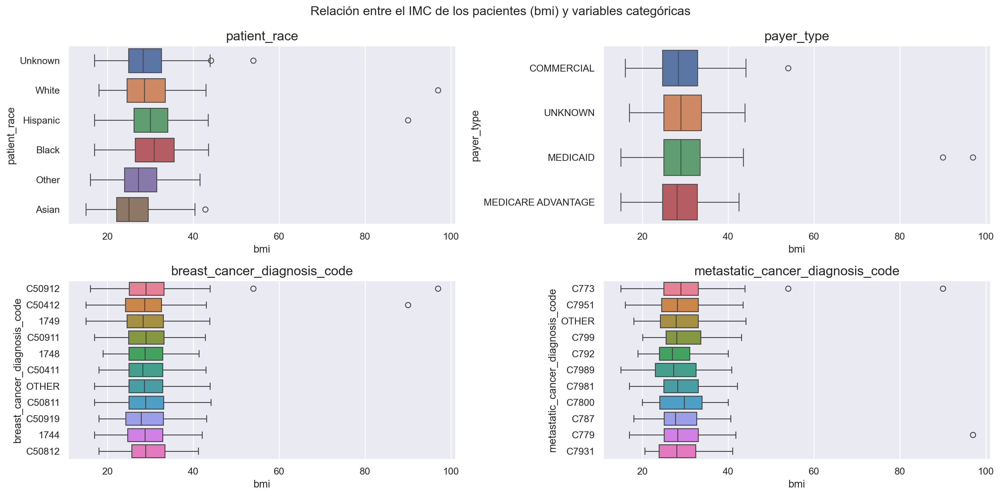

In [49]:
#Check the number of missing values
print(f"Valores perdidos: {df_numerical_study['bmi'].isna().sum()}")

# AGE DISTRIBUTION
# Create a histogram plot describing the distribution of the figure
fig = plt.figure(figsize=(12, 6))
sns.histplot(data=df_numerical_study,
             x="bmi",
             binwidth=2,
             kde=True);

# Set the axes and titles
plt.xlabel("Índice de masa corporal")
plt.ylabel("Frecuencia")
plt.suptitle("Distribución del IMC de los pacientes - bmi")

plt.tight_layout();
plt.show();

fig, axs = plt.subplots(2, 2, figsize=(16, 8))

# AGE DISTRIBUTION ACCORDING TO CATEGORICAL VARIABLES
# Plot the distribution of the age, according to every categorical variable being studied
for pos, variable in enumerate(categorical_variables):
    
    # Create a box plot
    sns.boxplot(data=df_numerical_study,
                x="bmi",
                y=variable,
                hue=variable,
                ax= axs[pos // 2][pos % 2])
    
    # Plot titles
    axs[pos // 2][pos % 2].set_title(variable, fontsize=15)

# Define the title and set a tight layour
plt.suptitle("Relación entre el IMC de los pacientes (bmi) y variables categóricas")
plt.tight_layout();
plt.show();

Lo primero que se observa es la **gran cantidad de valores perdidos** - más de **9000 valores**. La mayoría de instancias del conjunto de datos **tienen un valor desconocido del índice de masa corporal**. 

Por si sola, esta información podría ser suficiente para determinar que **la variable no aporta información util a la hora de predecir el tiempo de diagnóstico**. Ahora bien, en caso de que fuese a utilizar, sería necesario **imputar los valores perdidos**:
- No se pueden reemplazar por un valor por defecto - al no existir un valor predeterminado para el IMC.
- No tiene sentido reemplazar todos los valores por un único valor (promedio, mediana...) - como se observa en las gráficas, **hay cierta correlación entre algunas variables y el IMC**, que se perdería con una imputación tan general.
- La forma aparentemente más util de reemplazar los valores sería **sustituir los valores desconocidos por la mediana para la raza del paciente** - al ser este atributo categórico el que más influencia parece tener sobre el valor del IMC.

Por lo demás, estudiando la correlación entre el atributo y las variables categóricas:
- Parece existir cierta correlación entre **el IMC y la raza de los pacientes** - ignorando los valores extremos, hay una diferencia significativa entre algunas de las razas.
- Hay cierto cambio dependiendo del **código de diagnóstico de la metástasis**, si bien la influencia que ejerce parece menor a la de la raza.
- No se aprecia correlación significativa entre el IMC y el tipo de seguro o el código de diagnóstico del cancer de mama.

Si se observa la relación entre **el indice de masa corporal y el tiempo de diagnóstico**:

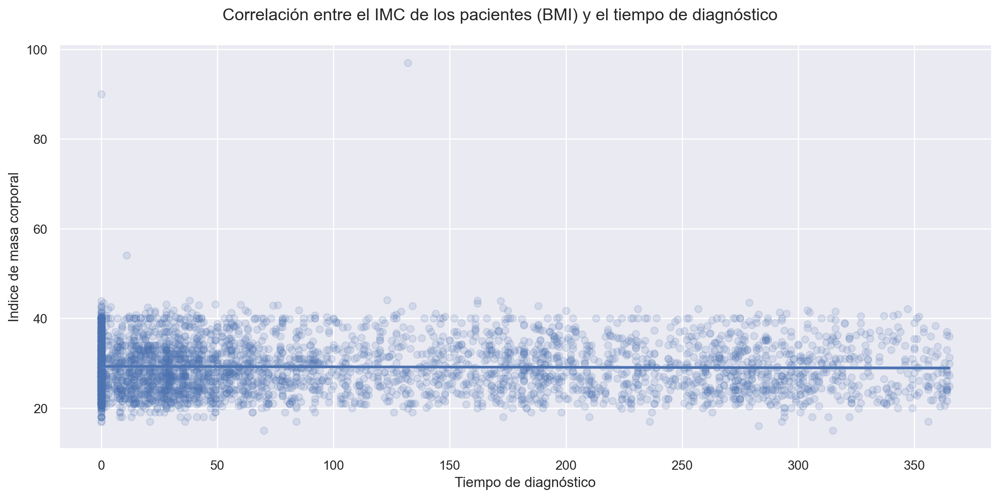

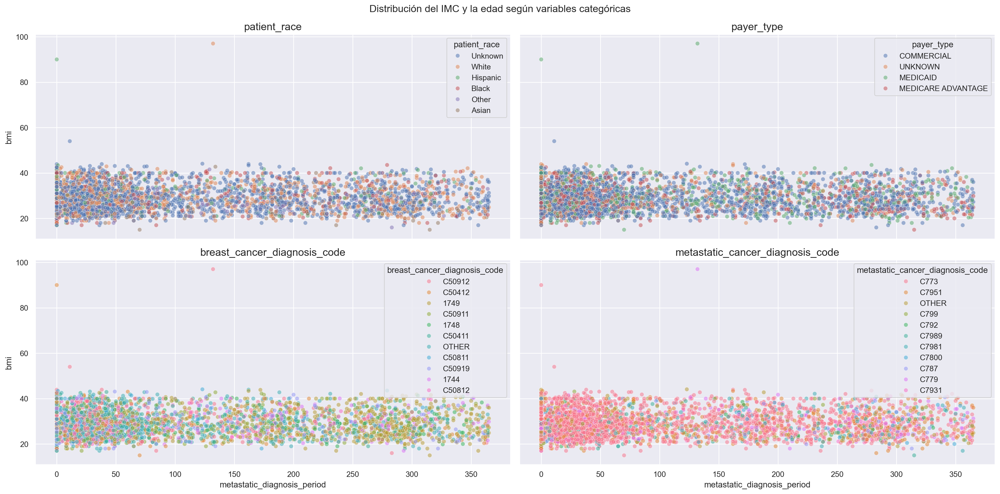

In [50]:
# CORRELATION BETWEEN BMI AND DIAGNOSIS TIME
# Create the figure
fig = plt.figure(figsize=(12, 6));

# Plot a regression figure showing the computed regression line
sns.regplot(data=df_numerical_study,
            x="metastatic_diagnosis_period",
            y="bmi",
            scatter_kws={"alpha": 0.15});

# Modify the labels and titles
plt.suptitle("Correlación entre el IMC de los pacientes (BMI) y el tiempo de diagnóstico");
plt.xlabel("Tiempo de diagnóstico");
plt.ylabel("Indice de masa corporal")
plt.tight_layout();
plt.show();


# CORRELATION BETWEEN BMI AND DIAGNOSIS TIME - ACCORDING TO OTHER CATEGORICAL VARIABLES
# Create the figure
fig, axs = plt.subplots(2, 2, figsize=(20, 10), sharex=True, sharey=True);

# Plot the age of the patients according to each categorical variable
for pos, variable in enumerate(categorical_variables):
    
    # Create a scatterplot
    sns.scatterplot(data=df_numerical_study,
                x="metastatic_diagnosis_period",
                y="bmi",
                hue=variable,
                alpha=0.5,
                ax= axs[pos // 2][pos % 2]);
    
    # Plot titles
    axs[pos // 2][pos % 2].set_title(variable, fontsize=15);

# Define the title and set a tight layout
plt.suptitle("Distribución del IMC y la edad según variables categóricas");
plt.tight_layout();
plt.show();

De nuevo, se observa claramente que **no existe ninguna correlación entre el indice de masa corporal y el tiempo de diagnóstico**. De igual manera, **no parece que las variables categóricas aporten ninguna información adicional al respecto**.

Por tanto, se puede afirmar que **el índice de masa corporal no es un atributo relevante** a la hora de predecir el tiempo de diagnóstico de los pacientes.

---

<a id="section2-5"></a>

## 2.5. Estudio de atributos geoeconómicos y climáticos

Hasta el momento, se ha estudiado un subconjunto limitado de los atributos disponibles, todos relacionados con los **datos médicos** del paciente:
- Los **atributos categóricos**, excepto los relacionados con la ubicación geográfica del paciente.
- La **edad** y el **IMC** de los pacientes.

Ahora bien, parte del objetivo de este proyecto es **analizar si las variables geoeconómicas y climáticas tienen influencia en el tiempo de diagnóstico**. Ahora bien:
- El número de variables de este tipo es **excesivamente elevado** para ser estudiado en detalle.
- Los valores de estos datos no guardan relación directa con el paciente, sino con su **código zip** - lo que se traduce en que **todos los pacientes con el mismo código zip tendrían los mismos valores en estos atributos**.
- Como se observó durante el estudio de variables numéricas, **las variables geográficas están muy correlacionadas entre sí, pero tienen muy poca correlación con el tiempo de diagnóstico**.

Por tanto, para analizar en "bloque" este grupo de variables, se optará por realizar el siguiente estudio:
- Analizar los **atributos categóricos** representando la ubicación geográfica, y su **relación con el tiempo de diagnóstico**.
- Realizar un **estudio visual sobre un mapa** de algunas de las variables más significativas socioeconómicas y climáticas.

### - **Atributos categóricos: Ubicación geográfica (`patient_zip3`, `patient_state`, `Division`, `Region`)**

Todas las variables económicas, sociales y climáticas dependen directamente de la **ubicación geográfica del paciente** - y, específicamente, de su código zip. Por lo tanto, se puede entender que **la variable `patient_zip3` codifica la información de todas las demás variables**.

Por esto, si se realiza un estudio de la distribución y relevancia de esta variable y todas las relacionadas, se puede **estudiar la importancia de todos los factores descritos previamente** a la vez.

---

Siguiendo la definición que se ha realizado previamente de los atributos, se puede asumir que existe la siguiente **correlación entre los atributos**:

1. Una **región** (`Region`) contiene varias **divisiones** (`Division`).
2. Una **división** (`Division`) contiene varios **estados** (`patient_state`).
3. Un **estado** (`patient_state`) contiene varios **códigos zip** (`patient_zip3`).

De esta forma, **todos los atributos realmente representan la misma información** - variando únicamente la **granularidad**:

In [51]:
print(f"Número de regiones únicas: {df_categorical['Region'].nunique()}")

print(f"Número de divisiones únicas: {df_categorical['Division'].nunique()}")
print(f"\t- Número de divisiones por región (promedio): {df_categorical.groupby('Region')['Division'].nunique().mean()}")

print(f"Número de estados únicos: {df_categorical['patient_state'].nunique()}")
print(f"\t- Número de estados por división (promedio): {df_categorical.groupby('Division')['patient_state'].nunique().mean()}")

print(f"Número de códigos zip únicos: {df_categorical['patient_zip3'].nunique()}")
print(f"\t- Número de códigos zip por estado (promedio): {df_categorical.groupby('patient_state')['patient_zip3'].nunique().mean()}")

Número de regiones únicas: 4
Número de divisiones únicas: 8
	- Número de divisiones por región (promedio): 2.0
Número de estados únicos: 44
	- Número de estados por división (promedio): 5.625
Número de códigos zip únicos: 751
	- Número de códigos zip por estado (promedio): 17.113636363636363


Como se puede ver, **la granularidad aumenta rápidamente** al aumentar el número de divisiones:
- El número de regiones (4) y divisiones (8) es razonable para ser estudiado de forma más individualizada.
- El número de estados (44) se puede estudiar de forma similar a como se han estudiado los códigos - comprobando la distribución general y observando los valores de los estados más frecuentes.
- El número de códigos zip (751) es excesivamente elevado como para estudiarlo de forma adecuada, pero se pueden realizar algunas observaciones.

Para comprobar la validez de los datos y que la relación descrita se cumple realmente, se comprueba que **la granularidad se cumpla en dirección contraria** - es decir, que (por ejemplo) **cada división pertenezca únicamente a una región**:

In [52]:
print(f"Número de regiones a los que pertenece cada división (promedio): {df_categorical.groupby('Division')['Region'].nunique().mean()}")
print(f"Número de divisiones a los que pertenece cada estado (promedio): {df_categorical.groupby('patient_state')['Division'].nunique().mean()}")
print(f"Número de estados a los que pertenece cada código zip (promedio): {df_categorical.groupby('patient_zip3')['patient_state'].nunique().mean()}")

Número de regiones a los que pertenece cada división (promedio): 1.0
Número de divisiones a los que pertenece cada estado (promedio): 1.0227272727272727
Número de estados a los que pertenece cada código zip (promedio): 1.0026631158455392


Parece ser que existen algunos casos en los que no se cumplen estas restricciones - concretamente:
- Algunos **estados** pertenecen a **dos o más divisiones**.
- Algunos **códigos zip** pertenecen a **dos o más estados**

Estudiando la distribución de los **estados** en cada división:

In [53]:
(
    df_categorical[["Division", "patient_state"]]                               # 1 - Obtain the division and patient_state
    [df_categorical["patient_state"].isin(                                      # 2 - Extract only the instances with a state in more than 2 divisions
      (df_categorical.groupby('patient_state')['Division'].nunique() >= 2).index[(df_categorical.groupby('patient_state')['Division'].nunique() >= 2)].tolist()  
    )]
    .groupby(["patient_state", "Division"]).agg(count=("patient_state", len))   # 3 - Group by patient state AND division, and count
)

count
patient_state Division       
CA            Mountain      1
              Pacific    2376

Sorprendentemente, el problema ocurre **únicamente en una instancia de un estado** - el estado de California está en la división de **Pacific**, excepto por una instancia que lo clasifica como **Mountain**. [Datos externos](https://en.wikipedia.org/wiki/List_of_regions_of_the_United_States) confirman que California debería pertenecer a Pacific.

Si se estudia la distribución de los **códigos zip** en cada estado:

In [54]:
(
    df_categorical[["patient_state", "patient_zip3"]]                                     # 1 - Obtain the division and patient_state
    [df_categorical["patient_zip3"].isin(                                                 # 2 - Extract only the instances with a state in more than 2 divisions
      (df_categorical.groupby('patient_zip3')['patient_state'].nunique() >= 2).index[(df_categorical.groupby('patient_zip3')['patient_state'].nunique() >= 2)].tolist()  
    )]
    .groupby(["patient_zip3", "patient_state"]).agg(count=("patient_state", len))         # 3 - Group by patient zip code AND state, and count
    
)

count
patient_zip3 patient_state       
630          IL                 1
             MO                22
864          AZ                 4
             CA                 1

De nuevo, parecen ser errores de anotación a la hora de crear el conjunto de datos. [Datos externos](https://simple.wikipedia.org/wiki/List_of_ZIP_Code_prefixes) confirman que:
- El código **630** pertenece a **Missouri** (MO).
- El código **864** pertenece a **Arizona** (AZ).

En ambos casos, lo más lógico es asumir que las incongruencias se deben a **errores durante la creación del conjunto de datos** que pueden ser resueltas durante el preprocesamiento de los datos.

Teniendo la certeza de que **los cuatros atributos representan la misma información con distinta granularidad**, se puede entonces **estudiar en más detalle alguno de los atributos** y extrapolarlo al resto de atributos del conjunto de datos.

---

El siguiente paso consiste en estudiar la **distribución de las variables directamente**, junto a la **relación que hay entre ellas y el tiempo de diagnóstico**. 

Para ello, el primer paso consiste en crear una **tabla** que almacene la información, y sobre la que se trabajará posteriormente:

In [55]:
# Compute the correlation of region - division - state - zip, plus the number of patients per region
df_geographical_frequency = (
    df_metastasis[["Region", "Division", "patient_state", "patient_zip3"]]
    .groupby(["Region", "Division", "patient_state", "patient_zip3"]).agg(count=("patient_zip3", len))
)

display(df_geographical_frequency)

count
Region  Division           patient_state patient_zip3       
Midwest East North Central IL            600             117
                                         601              95
                                         602               3
                                         603               3
                                         604             144
...                                                      ...
West    Pacific            WA            990               7
                                         991               5
                                         992              11
                                         993               7
                                         994               1

[753 rows x 1 columns]

Como se observó previamente, el tamaño de la tabla es excesivo para ser estudiada de forma directa en este formato, al tener **753 entradas** - correspondiendose con los **753 códigos zip** del conjunto de datos. 

Por esto, se realizará un estudio **gráfico** de los distintos niveles mediante gráficas de barras y mapas coropléticos. Ahora bien, antes de poder representar estos gráficos es necesario el orden (de mayor a menor número de pacientes) de las divisiones:

In [56]:
# Extract the order of regions, divisions and states
region_order = df_geographical_frequency.groupby("Region")["count"].sum().sort_values(ascending=False).index.to_list()
division_order = df_geographical_frequency.groupby("Division")["count"].sum().sort_values(ascending=False).index.to_list()
state_order = df_geographical_frequency.groupby("patient_state")["count"].sum().sort_values(ascending=False).index.to_list()

# Extract the order of divisions PER REGION
division_per_region_order_dict = {key: df_geographical_frequency.xs(key).groupby("Division")["count"].sum().sort_values(ascending=False).index.to_list() for key in region_order}
division_per_region_order = list(itertools.chain(*division_per_region_order_dict.values()))

# Extract the order of states PER REGION
state_per_region_order_dict = {key: df_geographical_frequency.xs(key).groupby("patient_state")["count"].sum().sort_values(ascending=False).index.to_list() for key in region_order}
state_per_region_order = list(itertools.chain(*state_per_region_order_dict.values()))

#### - Región y división geográfica

A la hora de trabajar con la **región** y la **división** de los pacientes, el número reducido de posibles valores - **4 regiones** y **8 divisiones** respectivamente - hace posible su representación como a través de un **gráfico de barras** estándar.



El primer paso es comprobar la **distribución de los atributos** - individualmente y de forma comparativa:

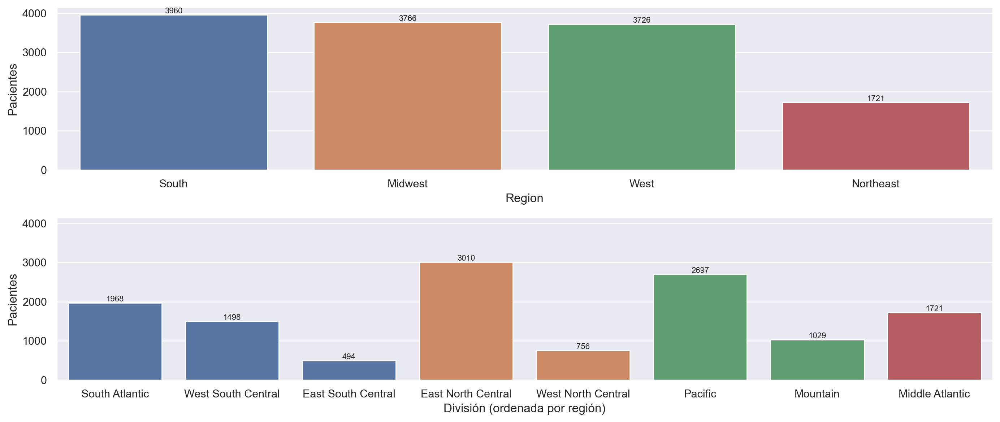

In [57]:
# Region on top, Division on the bottom
fig, axs = plt.subplots(2, 1, 
                        figsize=(14, 6),
                        sharey=True);

# Region distribution
sns.countplot(data=df_metastasis,
              x="Region",
              hue="Region",
              order=region_order,
              ax=axs[0]);

# Plots with hue have several containers, so the bar label has to be iterated
for container in axs[0].containers:
    axs[0].bar_label(container, fontsize=8);
axs[0].set(ylabel="Pacientes");

# Division distribution
sns.countplot(data=df_metastasis,
              x="Division",
              hue="Region",
              order=division_per_region_order,
              legend=False,
              ax=axs[1]);
# Plots with hue have several containers, so the bar label has to be iterated
for container in axs[1].containers:
    axs[1].bar_label(container, fontsize=8);
axs[1].set(ylabel="Pacientes", xlabel="División (ordenada por región)");

plt.tight_layout();
plt.show();

Centrandonos en la **región de los pacientes**, parece haber cierto desequilibrio:
- A simple vista, parece haber **tres regiones** (*South*, *Midwest* y *West*) con mayores frecuencias y cantidades similares de pacientes.
- En cambio, ***Northeast*** tiene menos de la mitad de pacientes que el resto de regiones.

Ahora bien, si se desglosan estas regiones en **divisiones** - manteniendo los colores para mayor claridad -, se observa que **las divisiones internas de cada región no están tan equilibradas entre sí**:
- En la región *South* hay contenidas **tres divisiones**:
    - Dos de ellas tienen proporciones similares, pero de tamaños parecidos al de la región más pequeña (*Northeast*)
    - La ultima división (*East South Central*) tiene, sorprendentemente,  el menor número de pacientes.
- Las regiones *Midwest* y *West* se han dividido en **dos divisiones** con comportamientos similares:
    - Una de las divisiones tiene una cantidad de pacientes **notablemente superior** - entre tres y cuatro veces - a la de la división más pequeña.
- *Northeast* contiene una **única división** - lo que se traduce en que ha pasado de ser la región más pequeña a **una de las divisiones más grandes**.

Se puede comprobar la distribución de las divisiones si se ordenan únicamente por el **número de pacientes**:

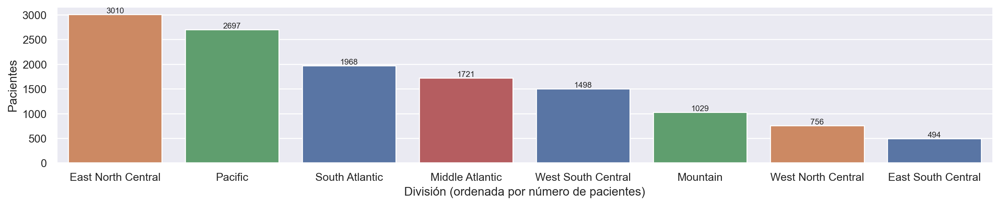

In [58]:
fig = plt.figure(figsize=(14, 3))

# Division distribution
sns.countplot(data=df_metastasis,
              x="Division",
              hue="Region",
              legend=False,
              order=division_order);

# Plots with hue have several containers, so the bar label has to be iterated
for container in fig.gca().containers:
    fig.gca().bar_label(container, fontsize=8);
fig.gca().set(ylabel="Pacientes", xlabel="División (ordenada por número de pacientes)");

plt.tight_layout();
plt.show();

En esta gráfica se observa mejor el fenómeno que se ha comentado antes - el fraccionamiento de regiones en divisiones ha provocado que **se acrecente el desequilibrio en la distribución de pacientes**, siendo la división más poblada aproximadamente **seis veces más grande** que la menos poblada.

Aun así, **todas las divisiones tienen una cantidad suficiente de pacientes** como para ser utilizadas durante el entrenamiento.

---

El siguiente paso consiste en estudiar como se corresponde el **tiempo de diagnóstico** - la variable objetivo - con los valores de **región y división**. En esta ocasión, se estudia únicamente utilizando un **diagrama de cajas y bigotes**:

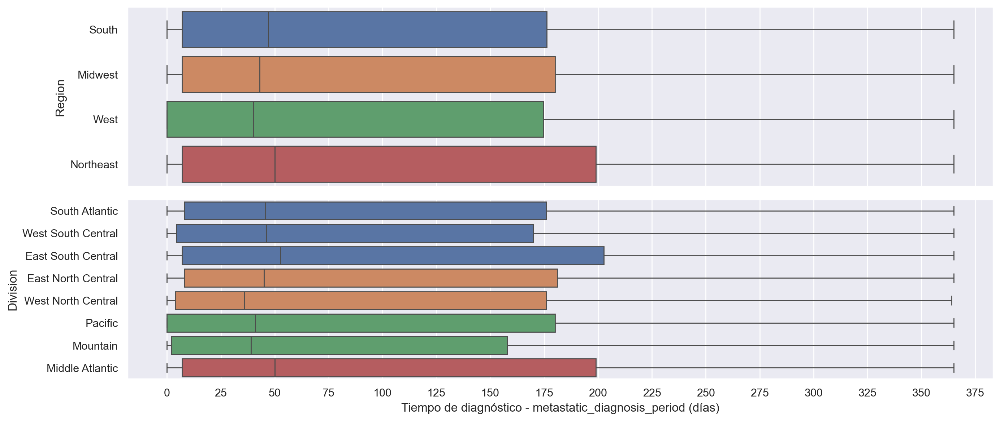

In [59]:
# Region on top, Division on the bottom
fig, axs = plt.subplots(2, 1, 
                        figsize=(14, 6),
                        sharex=True);

# Region boxplot
sns.boxplot(data=df_metastasis,
            x="metastatic_diagnosis_period",
            y="Region",
            hue="Region",
            order=region_order,
            ax=axs[0]);

# Division boxplot
sns.boxplot(data=df_metastasis,
            x="metastatic_diagnosis_period",
            y="Division",
            hue="Region",
            order=division_per_region_order,
            legend=False,
            ax=axs[1]);

# Specify titles and axes
axs[1].set(xlabel="Tiempo de diagnóstico - metastatic_diagnosis_period (días)");
axs[1].set_xticks(range(0, 400, 25));

plt.tight_layout();
plt.show();

Estudiando primero la distribución respecto a la **región**, se observa que **el valor medio** y **el rango** de las cuatro regiones es muy similar. Observando con más detalle:
- Las regiones *South* y *Midwest* tienen distribuciones muy parecidas - si bien el valor medio del tiempo de diagnóstico es **ligeramente inferior** en *Midwest*, el rango es prácticamente idéntico.
- Las regiones *West* (con un rango inferior) y *Northeast* (con un rango superior) parecen estar más alejadas de los extremos, pero la diferencia sigue siendo reducida.

Una vez más, desglosando estas regiones en **divisiones** cambia ligeramente el comportamiento, aunque sigue sin haber muchas diferencias entre ellas. En más detalle:
- Dentro de la región *South*, la división ***East South Central*** tiene un comportamiento prácticamente idéntico al de *Northeast* - el extremo superior de las regiones.
- Pese a que la región *West* era la región con el extremo inferior más bajo, el **valor medio más bajo** se encuentra ahora en ***West North Central*** - una división dentro de *Midwest*.

---

Se puede comprobar también mediante tests si **existe una diferencia estadísticamente significativa** en el tiempo de diagnóstico dependiendo de la **región** o **división** del paciente. Para esto, se plantea un **test de hipótesis** con un **nivel de significación del 95%** ($\alpha=0.05$):

- $H_0$: La media del tiempo de diagnóstico es igual para todas las regiones / divisiones.
- $H_1$: La media del tiempo de diagnóstico es **distinta** en alguna región / división.

In [60]:
# REGION ###
# ANOVA (parametric test)
region_anova = f_oneway(*[df_metastasis[df_metastasis["Region"]==region]["metastatic_diagnosis_period"].to_list() for region in df_metastasis["Region"].unique()])

# Kruskal-Wallis (non-parametric)
region_kruskal = kruskal(*[df_metastasis[df_metastasis["Region"]==region]["metastatic_diagnosis_period"].to_list() for region in df_metastasis["Region"].unique()])

categorical_p_values["region"] = {
    "anova": region_anova[1],
    "kruskal": region_kruskal[1]
}

# DIVISION ###
division_anova = f_oneway(*[df_metastasis[df_metastasis["Division"]==division]["metastatic_diagnosis_period"].to_list() for division in df_metastasis["Division"].unique()])

# Kruskal-Wallis (non-parametric)
division_kruskal = kruskal(*[df_metastasis[df_metastasis["Division"]==division]["metastatic_diagnosis_period"].to_list() for division in df_metastasis["Division"].unique()])

categorical_p_values["division"] = {
    "anova": division_anova[1],
    "kruskal": division_kruskal[1]
}

print("P-Valores (Región):")
print(f"\t- ANOVA: {categorical_p_values['region']['anova']}")
print(f"\t- Kruskal-Wallis: {categorical_p_values['region']['kruskal']}")

print("P-Valores (División):")
print(f"\t- ANOVA: {categorical_p_values['division']['anova']}")
print(f"\t- Kruskal-Wallis: {categorical_p_values['division']['kruskal']}")

P-Valores (Región):
	- ANOVA: 0.002795888840887194
	- Kruskal-Wallis: 1.93434080162336e-06
P-Valores (División):
	- ANOVA: 0.006127870033806849
	- Kruskal-Wallis: 1.6757696664752917e-05


En ambos casos, el test estadístico muestra que **existe una diferencia significativamente estadística entre los distintos valores de los atributos** - si bien la diferencia es pequeña. Por tanto, se podría considerar que **la variable puede tener cierto interés a la hora de crear los modelos**.

Ahora bien, como curiosidad se puede observar que **la diferencia es estadísticamente menos significativa con los datos más granulares** - en contra de lo que se podría esperar. Falta por ver si se mantiene esta tendencia con el resto de variables.

#### - Estado

Como se estudió al principio de esta sección, el conjunto de datos contiene pacientes de **44 estados distintos** - una cantidad notablemente superior al número de regiones (4) o divisiones(8). Además, **los estados contenidos en el conjunto de datos no son exhaustivos** - los datos del conjunto de test **podrían contener estados no estudiados hasta el momento**, al existir realmente **50 estados**.

Estudiando la **distribución** de los pacientes, y dividiéndola por **regiones**:

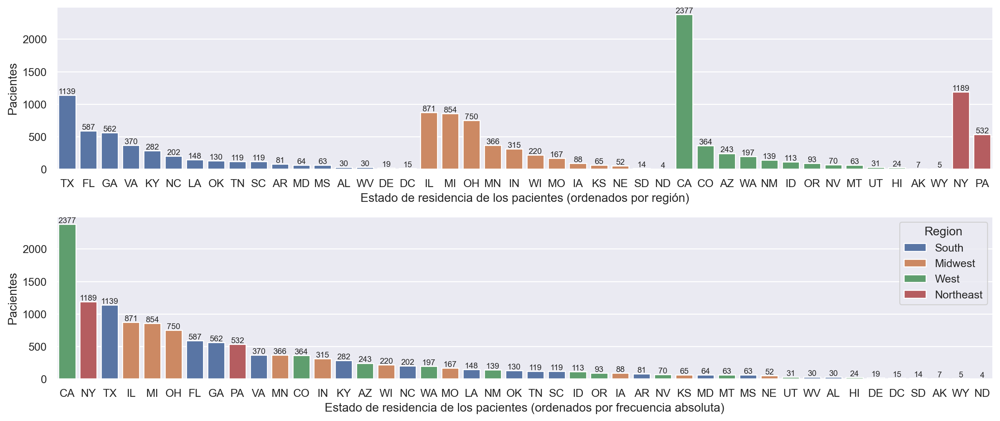

In [61]:
# Create the figure
fig, axs = plt.subplots(2, 1,
                   figsize=(14, 6),
                   sharey=True);

# Create the barcharts using Seaborn, to use hue
# Barchart 1 - Ordered by region
sns.countplot(df_metastasis,
              x="patient_state",
              hue="Region",
              order=state_per_region_order,
              legend=False,
              ax=axs[0])
axs[0].set(ylabel="Pacientes",
           xlabel="Estado de residencia de los pacientes (ordenados por región)")
# Plots with hue have several containers, so the bar label has to be iterated
for container in axs[0].containers:
    axs[0].bar_label(container, fontsize=8);

# Barchart 1 - Ordered by size
sns.countplot(df_metastasis,
              x="patient_state",
              hue="Region",
              order=state_order,
              ax=axs[1])
axs[1].set(ylabel="Pacientes",
           xlabel="Estado de residencia de los pacientes (ordenados por frecuencia absoluta)")
# Plots with hue have several containers, so the bar label has to be iterated
for container in axs[1].containers:
    axs[1].bar_label(container, fontsize=8);

plt.tight_layout();
plt.show();

Se observa que **cuanto mayor es la granularidad, mayor es el desbalanceo en la distribución de los pacientes**. Analizando en más detalle:
- El **estado más poblado** (*CA*) tiene más del doble de pacientes que el siguiente estado de mayor población (*NY*).
- Hay **gran cantidad de estados con menos de 50 pacientes**, algunos llegando a no superar los **diez pacientes**. Esto se traduce en **valores de la variable con demasiada poca representación para ser usados en el modelo**.
- Si se observa la distribución dentro de cada región, **la mayoría de pacientes se concentran en entre uno y tres estados** - teniendo el resto de estados de la región una cantidad mucho inferior de pacientes.

Ahora bien, estudiar la distribución de los pacientes en esta gráfica **ignora el componente geográfico** - no es posible observar si hay **algún tipo de correlación geográfica** entre las poblaciones de los estados. Para estudiar esto, se muestra un **mapa coroplético** de los Estados Unidos, utilizando un gradiente para mostrar la **frecuencia de pacientes**:

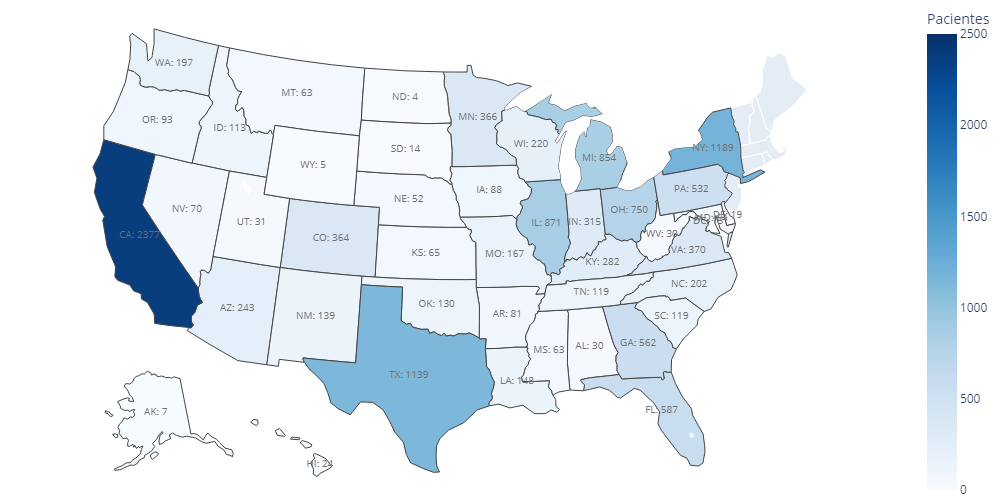

In [62]:
df_states_frequency = df_metastasis.groupby("patient_state").agg(size=("patient_state", "size")).reset_index()

# Use plotly to create a choropleth map
fig = px.choropleth(df_states_frequency,                # Use the number of elements within each group
                    color="size",                       # Use the size of each state for the heatmap
                    locations="patient_state",          # Use the name of the states for geographical information
                    locationmode="USA-states",                                                                      
                    scope="usa",                        # Display only the USA map
                    labels={"size": "Pacientes"},       # Change the name of the heatmap bar
                    color_continuous_scale="blues",
                    range_color=(0, 2500))              # Change the range of the heatmap bar

# Add the number of patients to each state
fig.add_scattergeo(locations=df_states_frequency["patient_state"],                                                  # Use the name of the states for geographical information
                   locationmode="USA-states",
                   text=df_states_frequency["patient_state"] + ": " + df_states_frequency["size"].astype(str),      # Write the state name and the patient count
                   textfont={                                                                                       # White text with black shadow for better readability
                       "color": "#6F6F6F",
                       "size": 10
                   },
                   mode="text")                                                                                     # Print the information as text

# Update the size and the margins of the graph
fig.update_layout(width=1000, height=500, margin={"r":0,"t":0,"l":0,"b":0})

# Display a static image instead of the interactive one
states_frequency_image = PIL.Image.open(io.BytesIO(fig.to_image(format="png")))
Image(fig.to_image(format="png"))

En principio, no parece haber una **correlación gráfica fuerte** en la distribución de los pacientes - hay estados concretos con una población de pacientes notablemente superior (como *CA*, *TX* o *NY*), mientras que el resto de estados tiende a tener poblaciones escasas.

---

Para estudiar la correlación entre **el estado de residencia de los pacientes** y su **tiempo de diagnóstico** se muestra otro mapa coroplético - mostrando el **valor promedio** y la **desviación estandar** de cada estado:

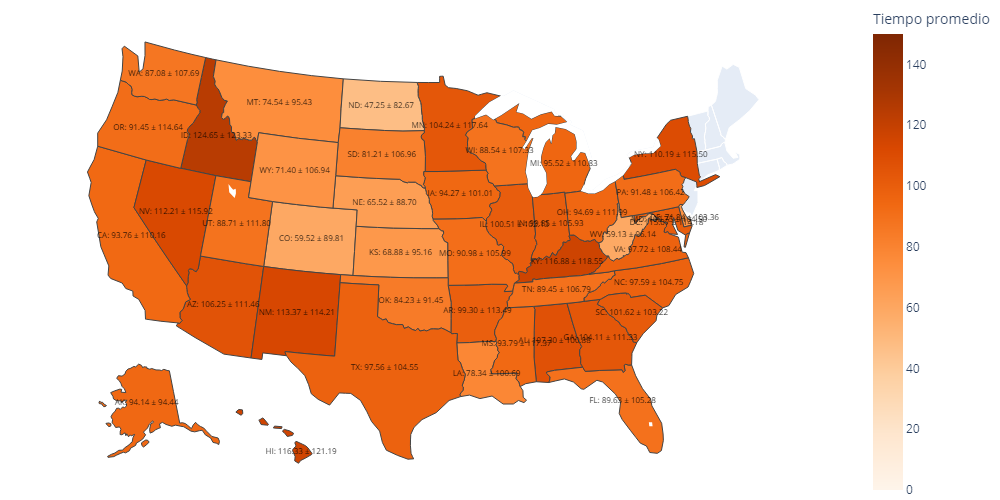

In [63]:
df_states_metastasis_period = df_metastasis.groupby("patient_state").agg(mean=("metastatic_diagnosis_period", "mean"), std=("metastatic_diagnosis_period", "std")).reset_index()

# Use plotly to create a choropleth map
fig = px.choropleth(df_states_metastasis_period,                                # Use the number of elements within each group
                    color="mean",                                               # Use the size of each state for the heatmap
                    locations="patient_state",                                  # Use the name of the states for geographical information
                    locationmode="USA-states",                                                                      
                    scope="usa",                                                # Display only the USA map
                    labels={"mean": "Tiempo promedio"},          # Change the name of the heatmap bar
                    color_continuous_scale="oranges",
                    range_color=(0, 150))                              # Change the range of the heatmap bar

# Add the number of patients to each state
fig.add_scattergeo(locations=df_states_metastasis_period["patient_state"],                                                  # Use the name of the states for geographical information
                   locationmode="USA-states",
                   text=(df_states_metastasis_period["patient_state"] + ": " 
                         + df_states_metastasis_period["mean"].map("{:.2f}".format) + " ± " 
                         + df_states_metastasis_period["std"].map("{:.2f}".format)),          # Write the state name and the patient count
                   textfont={                                                                                       # White text with black shadow for better readability
                       "color": "black",
                       "size": 8
                   },
                   mode="text")                                                                                     # Print the information as text

# Update the size and the margins of the graph
fig.update_layout(width=1000, height=500, margin={"r":0,"t":0,"l":0,"b":0})

# Display a static image instead of the interactive one
states_mean_image = PIL.Image.open(io.BytesIO(fig.to_image(format="png")))
Image(fig.to_image(format="png"))

Se puede observar que:
- El tiempo de diagnóstico promedio de los pacientes es **bastante similar** en todos los estados - incluso contando los casos extremos, no hay una diferencia significativa entre estados.
- La **desviación estandar de la media** es muy elevada en todos los valores promedio - en general, cercana a **cien dias** de variación.
    - Aunque se podría pensar que esto se debe a **estados con poblaciones muy escasas**, esto sigue ocurriendo en estados como *CA* - teniendo una desviación estandar de **110** a pesar de tener la población más elevada.

En general, parece que **la distribución del tiempo de diagnóstico es muy amplia independientemente del estado en el que se encuentren los pacientes**. 

Esta afirmación se podría comprobar visualmente a través de un diagrama de **cajas y bigotes** - ahora bien, el gran número de estados con pocos pacientes puede introducir sesgos al no ser representativos los datos. Para evitar este problema, se procede a **agrupar los estados con un número reducido de pacientes**:

In [64]:
# CREATE THE DATA - Grouping all patients in states with less than the specified number of patients
npatients = 150

df_patient_states_grouped = (
    df_metastasis.replace({
        "patient_state": (df_metastasis["patient_state"].value_counts() < npatients).index[(df_metastasis["patient_state"].value_counts() < npatients) == True]
    }, value="OTHER")
)

El diagrama de cajas y bigotes resultantes, con los estados agrupados, es el siguiente:

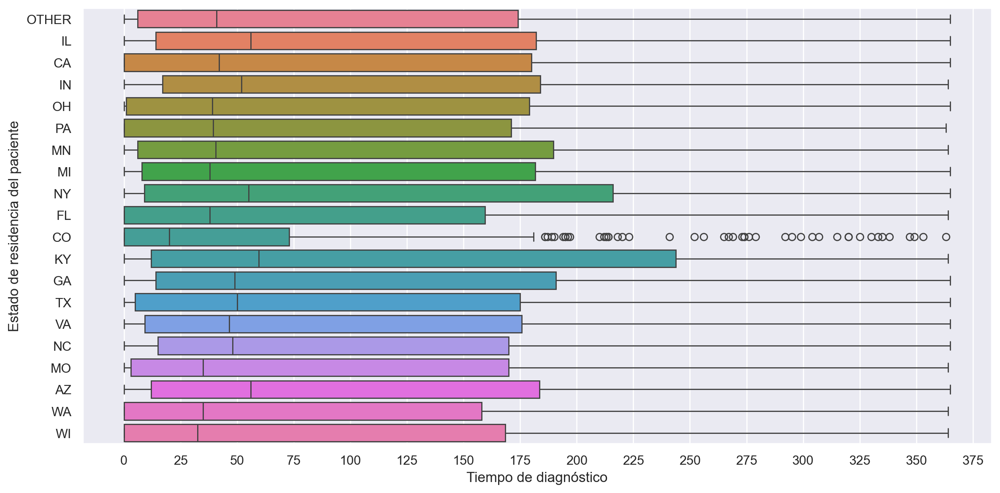

In [65]:
# DISPLAY THE FIGURE
plt.figure(figsize=(12, 6));

# Only a box-plot is shown this time, since a KDE plot would be too busy to be understood
sns.boxplot(
    data=df_patient_states_grouped,
    y="patient_state",
    hue="patient_state",
    x="metastatic_diagnosis_period"
);

plt.ylabel("Estado de residencia del paciente")
plt.xlabel("Tiempo de diagnóstico")
plt.xticks(range(0, 400, 25));


# Show the figure
plt.tight_layout();
plt.show();

Como se puede observar:
- El **rango de distribución** del tiempo de diagnóstico es **amplio** para todos los estados.
- En contra de lo que se veía con las regiones y las divisiones, **existen diferencias mas pronunciadas entre estados**, aunque la mediana siga estando cercana en la mayoría de casos.:
    - ***CO*** tiene un rango de diagnóstico y una mediana notablemente inferior - si bien sigue teniendo varios valores extremos fuera de dicho rango.
    - ***KY*** tiene un rango de diagnóstico sustancialmente superior, aunque su **mediana** sea similar al de otros estados.

---

Se puede comprobar también mediante tests si **existe una diferencia estadísticamente significativa** en el tiempo de diagnóstico dependiendo del estado de residencia de los pacientes. Para esto, se plantea un **test de hipótesis** con un **nivel de significación del 95%** ($\alpha=0.05$):

- $H_0$: La media del tiempo de diagnóstico es igual para todas los estados.
- $H_1$: La media del tiempo de diagnóstico es **distinta** en algún estado.

In [66]:
# WITHOUT GROUPING
# Compute the Anova and Kruskal p-values for the patient states
state_anova = f_oneway(*[df_metastasis[df_metastasis["patient_state"]==state]["metastatic_diagnosis_period"].to_list() for state in df_metastasis["patient_state"].unique()])
state_kruskal = kruskal(*[df_metastasis[df_metastasis["patient_state"]==state]["metastatic_diagnosis_period"].to_list() for state in df_metastasis["patient_state"].unique()])

categorical_p_values["state"] = {
    "anova": state_anova[1],
    "kruskal": state_kruskal[1]
}

# WITHOUT GROUPING
# Compute the Anova and Kruskal p-values for the patient states
state_grouped_anova = f_oneway(*[df_patient_states_grouped[df_patient_states_grouped["patient_state"]==state]["metastatic_diagnosis_period"].to_list() for state in df_patient_states_grouped["patient_state"].unique()])
state_grouped_kruskal = kruskal(*[df_patient_states_grouped[df_patient_states_grouped["patient_state"]==state]["metastatic_diagnosis_period"].to_list() for state in df_patient_states_grouped["patient_state"].unique()])

categorical_p_values["state_grouped"] = {
    "anova": state_grouped_anova[1],
    "kruskal": state_grouped_kruskal[1]
}

print("P-Valores (sin agrupar):")
print(f"\t- ANOVA: {categorical_p_values['state']['anova']}")
print(f"\t- Kruskal-Wallis: {categorical_p_values['state']['kruskal']}")

print("P-Valores (con agrupación):")
print(f"\t- ANOVA: {categorical_p_values['state_grouped']['anova']}")
print(f"\t- Kruskal-Wallis: {categorical_p_values['state_grouped']['kruskal']}")

P-Valores (sin agrupar):
	- ANOVA: 5.862544994732054e-10
	- Kruskal-Wallis: 1.0638653614967768e-16
P-Valores (con agrupación):
	- ANOVA: 6.734803556557013e-11
	- Kruskal-Wallis: 5.628093055795475e-18


Viendo los *p-valores* del atributo (tanto **sin agrupar** como **agrupados**) se puede afirmar que **la variable tiene diferencias estadísticas significativas entre los distintos valores** - por lo que puede resultar de interés a la hora de elegir los atributos para la creación de modelos de regresión.

Es de interés también destacar que **el paso de divisiones a estados ha aumentado la relevancia del atributo** - el estado al que pertenece cada paciente resulta más discriminatorio que conocer únicamente la división.

#### - Código zip

Representar visualmente la distribución de los pacientes según el código zip resulta complicada debido al **número elevado y no exhaustivo de códigos zips** contenidos en el conjunto de datos, y al tamaño reducido de estos:

In [67]:
print(f"Número de estados: {len(df_metastasis['patient_state'].unique())}")
print(f"Número de códigos zip: {len(df_metastasis['patient_zip3'].unique())}")
print(f"Número de pacientes por código zip (promedio): {df_metastasis.groupby('patient_zip3').size().mean()}")
print(f"Número de pacientes por código zip (desviación estandar): {df_metastasis.groupby('patient_zip3').size().std()}")


Número de estados: 44
Número de códigos zip: 751
Número de pacientes por código zip (promedio): 17.540612516644472
Número de pacientes por código zip (desviación estandar): 24.59930924011875


Por esto, resulta poco práctico **intentar realizar un estudio pormenorizado de cada código zip**. Para solventar este problema, se optará por estudiar la distribución de pacientes y sus tiempos de diagnóstico a través de **mapas coropléticos**.

Para poder realizar esto, es necesario:
- Cargar un *GeoDataFrame* conteniendo la **información geográfica de cada código zip**.
    - La información (en formato *Shapefile*) se ha obtenido del [siguiente enlace](https://github.com/gweissman86/three_digit_zips).
- Resumir la información de cada código zip en un *DatFrame*.

In [68]:
# Add the metastatic diagnosis period back to df_categorical
df_categorical["metastatic_diagnosis_period"] = df_metastasis["metastatic_diagnosis_period"]

# Read the geographical information (including geometry) as a Geopandas dataframe
gdf_zip3 = (
    gpd.read_file(r"data\three_digit_zips.zip")
    .rename(columns={"3dig_zip": "patient_zip3"})
)

# Compute statistics about each code - and replace NaN standard deviation values with 0
df_zip3 = (
    df_categorical.groupby("patient_zip3").agg(
        size=("metastatic_diagnosis_period", "size"),
        mean=("metastatic_diagnosis_period", "mean"),
        std=("metastatic_diagnosis_period", "std")
    )
    .fillna(0).reset_index()
)

Con los conjuntos de datos creados previamente, es posible representar la **distribución de los pacientes en los códigos zip conocidos** en el siguiente mapa:

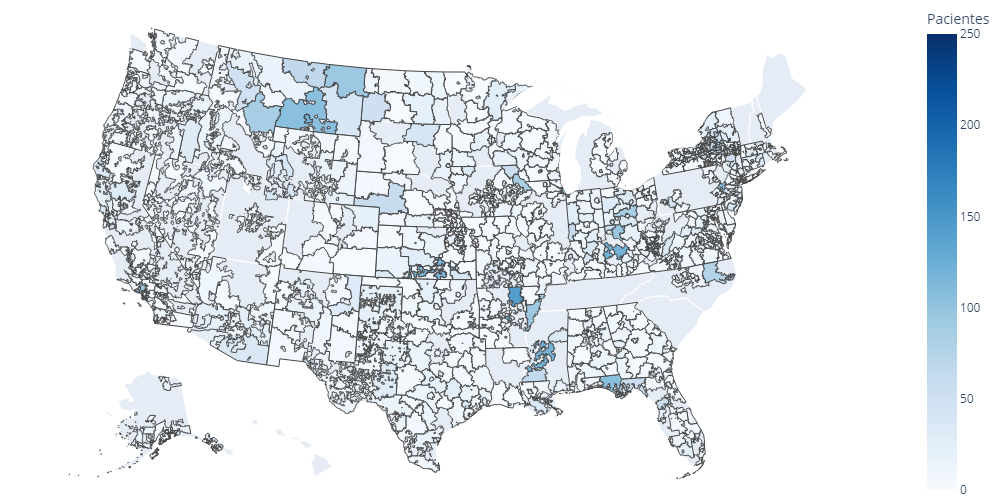

In [69]:
# Use plotly to create a choropleth map
fig = px.choropleth(df_zip3,                                            
                    geojson=gdf_zip3["geometry"],                               # Use the specified geometry
                    color="size",                                               # Use the size of each zip code area for color
                    locations=df_zip3["patient_zip3"],                          # Use the name of the states for geographical information                                                                     
                    scope="usa",                                                # Display only the USA map
                    labels={"size": "Pacientes"},                               # Change the name of the heatmap bar
                    color_continuous_scale="blues",
                    range_color=(0, 250))                                       # Change the range of the heatmap bar                                                                             # Print the information as text

# Update the size and the margins of the graph
fig.update_layout(width=1000, height=500, margin={"r":0,"t":0,"l":0,"b":0})

# Display a static image instead of the interactive one
zip3_mean_image = PIL.Image.open(io.BytesIO(fig.to_image(format="png")))
Image(fig.to_image(format="png"))

Ahora bien, **la información contenida en el mapa no se corresponde con lo esperado**:
- Estados como ***CA*** (el más poblado) tienen una distribución ínfima de pacientes.
- Estados mucho menos densos como ***MT*** - con **63 pacientes** - tienen códigos zips con colores indicando **cantidades de pacientes mucho mayores**.

Estudiando en más detalle el mapa interactivo para conocer el **código zip de las regiones inesperadas**, y estudiando el **estado que les corresponde**:

In [70]:
# Uncomment to display the interactive map - there is a notable slowdown otherwise
# fig.show()

print(f"Estado del código zip 480: {df_metastasis[df_metastasis['patient_zip3']==480]['patient_state'].unique()}")
print(f"Estado del código zip 482: {df_metastasis[df_metastasis['patient_zip3']==482]['patient_state'].unique()}")
print(f"Estado del código zip 483: {df_metastasis[df_metastasis['patient_zip3']==483]['patient_state'].unique()}")

Estado del código zip 480: ['MI']
Estado del código zip 482: ['MI']
Estado del código zip 483: ['MI']


Los tres códigos zip se corresponden al estado de **Michigan *(MI)*** - y no a **Montana *(MT)***, como indicaría su representación en el mapa. Esto puede deberse a **errores en la representación geográfica de los datos** en el conjunto de datos.

Debido a este problema durante el estudio y a la excesiva granularidad del atributo, **no tiene sentido proceder con el estudio** - siendo más razonable utilizar en su lugar el **estado en el que se ubican los pacientes** para representar la información geográfica.

### - **Atributos numéricos: Variables geoeconómicas y climáticas según la ubicación**

Como se ha comentado al comienzo de esta sección, **existe una correlación directa entre la ubicación geográfica del paciente y todas las variables no estudiadas hasta el momento**. 

Esto se debe a que estos atributos - porcentajes, valores promedios y medianas - representan **estadísticos sobre la población en un código zip concreto**, y no información específica de cada paciente. Por tanto, es lógico asumir que **todos los pacientes en un mismo código zip van a tener los mismo estadísticos** y, por tanto, **el código zip codifica toda la información relevante al respecto**.

Aun así, es de interés estudiar de nuevo las **correlaciones** entre atributos para ver si existe alguna variable altamente significativa - ignorando las variables ya estudiadas previamente:

In [71]:
# Compute the correlations - without age and BMI
df_numerical_corrs_social = df_numerical.drop(columns=["patient_age", "bmi"]).corr()

print("Correlaciones (incluyendo temperaturas):")
display(
    df_numerical_corrs_social.abs()                                                   # 1 - Obtain the absolute values                     
    .where(np.triu(np.ones(df_numerical_corrs_social.shape), k=1).astype(bool))       # 2 - To avoid duplicate values, extract only the upper triangle of the table
    .stack()                                                                          # 3 - Convert the table into an array
    .sort_values(ascending=False)                                                     # 4 - Sort the values and extract the top n values
    .nlargest(20)
)

# Compute the correlations - without temperature, age and BMI
df_numerical_corrs_social_no_temps = df_numerical_corrs_social.loc[~df_numerical_corrs_social.columns.str.startswith("Average"), ~df_numerical_corrs_social.columns.str.startswith("Average")]

print("Correlaciones (sin temperaturas):")
display(
    df_numerical_corrs_social_no_temps.abs()                                                    # 1 - Obtain the absolute values
    .where(np.triu(np.ones(df_numerical_corrs_social_no_temps.shape), k=1).astype(bool))        # 2 - To avoid duplicate values, extract only the upper triangle of the table
    .stack()                                                                                    # 3 - Convert the table into an array
    .sort_values(ascending=False)                                                               # 4 - Sort the values and extract the top n values
    .nlargest(20)
)

Correlaciones (incluyendo temperaturas):


male               female               1.000000
Average of Nov-13  Average of Nov-18    0.992653
Average of Jan-14  Average of Jan-18    0.991137
Average of Dec-14  Average of Dec-18    0.990306
Average of Jan-13  Average of Dec-18    0.988827
Average of Nov-18  Average of Dec-18    0.988793
Average of Mar-17  Average of Mar-18    0.988617
Average of Jan-13  Average of Dec-16    0.988205
Average of Dec-17  Average of Nov-18    0.988109
Average of Jan-16  Average of Nov-18    0.987622
Average of Dec-16  Average of Jan-17    0.987424
Average of Nov-13  Average of Dec-18    0.987016
Average of Dec-16  Average of Dec-18    0.986859
Average of Apr-14  Average of Mar-16    0.986842
Average of Nov-14  Average of Nov-18    0.986318
Average of Mar-14  Average of Mar-15    0.986117
Average of Nov-13  Average of Dec-17    0.986026
Average of Jan-16  Average of Feb-16    0.985963
Average of Jan-15  Average of Jan-18    0.985904
Average of Jan-13  Average of Jan-17    0.985684
dtype: float64

Correlaciones (sin temperaturas):


male                         female                         1.000000
population                   housing_units                  0.980959
income_household_median      income_household_six_figure    0.979312
income_household_150_over    income_household_six_figure    0.971842
education_bachelors          education_college_or_above     0.965783
income_household_median      income_household_150_over      0.964930
education_graduate           education_college_or_above     0.962566
married                      never_married                  0.928241
income_household_median      income_individual_median       0.914596
income_household_150_over    income_individual_median       0.910318
home_value                   rent_median                    0.906421
income_household_six_figure  income_individual_median       0.899902
age_median                   age_70s                        0.889101
income_household_150_over    rent_median                    0.888027
income_household_25_to_35    incom

Una vez más, se observa que las relaciones más fuertes se encuentran entre **atributos lógicamente correlacionados entre sí**:
- Las **temperaturas** cercanas en el tiempo tienen correlaciones muy fuertes entre sí - superior al `0.98`.
- Atributos **binarios** (como el género, dividido en los atributos ***Male*** y ***Female***) tienen también correlaciones muy fuertes.
- Otras correlaciones lógicas (como **ingresos superiores a 100.000 dolares** e **ingresos superiores a 150.000 dolares**) se cumplen como se podría esperar.

Ahora bien, **no se observa ninguna correlación con el tiempo de diagnóstico** entre las veinte correlaciones más importantes. Estudiando directamente la **correlación de los atributos con la variable de la clase**:

In [72]:
# Obtain the correlations to the class variable directly
top_corrs_social = df_numerical_corrs_social["metastatic_diagnosis_period"].drop("metastatic_diagnosis_period").abs().sort_values(ascending=False).nlargest(25)
print("Correlaciones con la variable objetivo:")
display(top_corrs_social)

# Show the number of variables
print(f"Número de variables: {len(df_numerical_corrs_social['metastatic_diagnosis_period'].drop('metastatic_diagnosis_period'))}")

Correlaciones con la variable objetivo:


labor_force_participation      0.039369
family_dual_income             0.036403
education_bachelors            0.033842
income_household_10_to_15      0.031975
Average of May-15              0.029484
poverty                        0.029135
widowed                        0.029086
income_household_15_to_20      0.028111
education_college_or_above     0.027753
family_size                    0.027333
income_household_under_5       0.026959
education_less_highschool      0.026777
income_household_75_to_100     0.026670
density                        0.026263
income_household_5_to_10       0.025621
race_black                     0.025422
unemployment_rate              0.025372
Average of Aug-16              0.024953
income_individual_median       0.024743
income_household_100_to_150    0.024134
age_40s                        0.024012
Average of Jul-13              0.023826
income_household_median        0.021839
race_white                     0.021431
disabled                       0.021218


Número de variables: 136


Igual que se observó la primera vez, **no existe ninguna correlación clara** entre los atributos geoeconómicos y climáticos, y el tiempo de diagnóstico promedio. Aun así, se opta por mostrar a escala reducida **la distribución del tiempo de diagnóstico según cada atributo**:

In [ ]:
# Create the figures
fig, axs = plt.subplots(nrows=17, ncols=8, figsize=(32, 68));

# For each figure
for pos, variable in enumerate(df_numerical_corrs_social['metastatic_diagnosis_period'].drop('metastatic_diagnosis_period').index.to_list()):

    # Plot a regression graph
    sns.regplot(data= df_numerical[[variable, "metastatic_diagnosis_period"]],
                x="metastatic_diagnosis_period",
                y=variable,
                scatter_kws={"s":5, "alpha": 0.20},
                ax=axs[pos // 8][pos % 8])

# Ensure that the layout has as little white space as available
plt.tight_layout();
Path(r"thesis/figs/chapter3/numerical/").mkdir(parents=True, exist_ok=True)
plt.savefig("thesis/figs/chapter3/numerical/allcorrelations.pdf", format="pdf", bbox_inches="tight")
plt.show();

ValueError: Image size of 6400x73600 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 3200x36800 with 136 Axes>

De forma definitiva - y sorprendente -, **no parece apreciarse ninguna correlación entre los atributos numéricos y la variable objetivo**.

Por esto, se puede afirmar que **no es relevante ninguno de los 136 atributos considerados** y, por tanto, no serán incluidos en los modelos creados posteriormente. Esto tiene sentido además si se considera que **se incluirá el estado de residencia de los pacientes** - un atributo que codifica de forma implícita la información de todos estos atributos.

---

<a id="section2-6"></a>

## 2.6. Conclusiones del análisis

En las secciones anteriores se ha realizado un **analisis exploratorio de datos (*EDA*)** exhaustivo para comprender tanto el **comportamiento individual de cada atributo** como **su correlación con la variable objetivo** - el tiempo de diagnóstico, con el objetivo de entender mejor el funcionamiento del conjunto de datos de cara a la creación de modelos de regresión.

Del estudio general, se pueden extraer las siguientes **conclusiones sobre el conjunto de datos**:

- Si bien la mayoría de pacientes tienen **un tiempo de diagnóstico relativamente bajo** (en el rango de los diez días), la distribución de los tiempos de diagnóstico tiene una **cola pronunciada hacia la derecha** - con una cantidad considerable de casos teniendo tiempos de diagnóstico notablemente más altos.
- Existe una **cantidad significativa de valores perdidos** en el conjunto de datos:
    - En la mayoría de atributos, la cantidad es suficientemente reducida como para poder **eliminar las instancias afectadas** sin afectar al estudio.
    - Existen algunas variables significativas - como la **raza** (`patient_race`) o el **tipo de seguro médico** (`payer_type`) - en la que la gran cantidad de valores perdidos podría afectar significativamente al estudio. Ahora bien, **se pueden considerar los valores perdidos como un valor único** para poder seguir utilizándolas.
    - El **tipo de tratamiento** (`metastatic_first_novel_treatment` y `metastatic_first_novel_treatment_type`) tiene que ser eliminado del estudio debido a la cantidad excesiva de valores perdidos - teniendo, en total, **11 valores conocidos** en todas las instancias.
- Para la mayoría de atributos categóricos, existe una **cantidad excesiva y sesgada de posibles valores**:
    - Algunos atributos (como el **estado** (`patient_state`) o los **códigos de diagnóstico** (`breast_cancer_diagnosis_code` y `metastatic_cancer_diagnosis_code`) ) tienen **más de 40 posibles valores** - y el atributo con más posibles valores, el **código zip** (`patient_zip3`), tiene alrededor de **700 posibles valores**.
    - Por definición, la mayoría de estos atributos **no son exhaustivos** - sería posible encontrar **datos no estudiados previamente** en el conjunto de test.
    - Existen sesgos en la distribución de estos valores - suele haber **grandes diferencias, de varios ordenes de magnitud**, entre los valores más y menos frecuentes.
    - Para lidiar con este problema, será necesario **agrupar los valores menos frecuentes de estos atributos** para reducir la dimensionalidad y evitar problemas de sobreajuste.

Además, los resultados concretos de este estudio - **p-valores** y **correlaciones** - se han ido almacenando, siendo los siguientes:

In [74]:
# Display the p-values of the categorical tests
print("Atributos categóricos (p-valores):")
display(pd.DataFrame.from_records(categorical_p_values).transpose().sort_values(by="anova"))

# Display the
print("Atributos numéricos (correlaciones):")
display(top_corrs)

Atributos categóricos (p-valores):


,anova,kruskal
breast_cancer_diagnosis,0.000000e+00,0.000000e+00
breast_cancer_diagnosis_grouped,0.000000e+00,NaN
metastatic_cancer_diagnosis_grouped,2.611114e-29,NaN
metastatic_cancer_diagnosis,5.118609e-22,1.333210e-21
payer_type,6.481698e-18,2.300181e-32
state_grouped,6.734804e-11,5.628093e-18
state,5.862545e-10,1.063865e-16
patient_race,2.363434e-05,2.657203e-09
payer_type_no_unknown,2.106249e-03,1.202497e-08
region,2.795889e-03,1.934341e-06


Atributos numéricos (correlaciones):


patient_age                   0.055231
labor_force_participation     0.039369
family_dual_income            0.036403
education_bachelors           0.033842
income_household_10_to_15     0.031975
Average of May-15             0.029484
poverty                       0.029135
widowed                       0.029086
income_household_15_to_20     0.028111
education_college_or_above    0.027753
family_size                   0.027333
income_household_under_5      0.026959
education_less_highschool     0.026777
income_household_75_to_100    0.026670
density                       0.026263
income_household_5_to_10      0.025621
race_black                    0.025422
unemployment_rate             0.025372
Average of Aug-16             0.024953
income_individual_median      0.024743
Name: metastatic_diagnosis_period, dtype: float64

Centrandonos en estos resultados para extraer conclusiones:

- Los **atributos médicos** tienen relevancia estadística a la hora de determinar el tiempo de diagnóstico - pero **no todos los atributos tienen la misma relevancia**:
    - Los atributos más significativos, con diferencia, son los referidos a los **códigos de diagnóstico** - tanto del **cancer de mama original** (`breast_cancer_diagnosis_code`) como de la **metástasis posterior** (`metastatic_cancer_diagnosis_code`). Intuitivamente, esto tiene sentido: los cánceres **más complicados de diagnosticar o más ocultos** van a necesitar más tiempo para ser diagnosticados.
    - La **raza de los pacientes** (`patient_race`) y el **tipo de seguro médico** (`payer_type`) tienen influencia sobre el tiempo de diagnóstico final, pero más reducida que los propios diagnósticos.
    - El resto de variables médicas **no son particularmente significativas para el estudio** - ya sea por la falta de correlación con el tiempo de diagnóstico (`patient_age` y `bmi`) o por la baja calidad de los datos (`patient_gender` y `metastatic_first_novel_treatment`)
- En contra de lo que se podría esperar intuitivamente - y del propio planteamiento del enunciado -, **los atributos geográficos, socioeconómicos y climáticos son irrelevantes para el tiempo de diagnóstico**:
    - Pese a tener un total de **136 atributos numéricos**, la correlación de todos estos atributos con el tiempo de diagnóstico está en el rango $[0.02-0.05]$ - mostrando que **no existe correlación**.
    - De todos los atributos asociados a la ubicación geográfica, el más significativo es el **estado de residencia del paciente** (`patient_state`) - codificando el valor de **todos los demás atributos de este tipo**.
    - Esta falta de correlación puede deberse a que, como se describe en Kaggle, **los datos se añadieron posteriormente a la información médica** con el fin de enriquecerla. Al ser datos "genéricos" asociados al código zip directamente y no a cada paciente, no existe una correlación tan directa.

---